In [1]:
# This Python 3 environment comes with many helpful analytics libraries installed
# It is defined by the kaggle/python Docker image: https://github.com/kaggle/docker-python
# For example, here's several helpful packages to load

import numpy as np # linear algebra
import pandas as pd # data processing, CSV file I/O (e.g. pd.read_csv)

# Input data files are available in the read-only "../input/" directory
# For example, running this (by clicking run or pressing Shift+Enter) will list all files under the input directory

import os
for dirname, _, filenames in os.walk('/kaggle/input'):
    for filename in filenames:
        print(os.path.join(dirname, filename))

# You can write up to 20GB to the current directory (/kaggle/working/) that gets preserved as output when you create a version using "Save & Run All" 
# You can also write temporary files to /kaggle/temp/, but they won't be saved outside of the current session

/kaggle/input/celeba-dataset/list_landmarks_align_celeba.csv
/kaggle/input/celeba-dataset/list_eval_partition.csv
/kaggle/input/celeba-dataset/list_attr_celeba.csv
/kaggle/input/celeba-dataset/list_bbox_celeba.csv


KeyboardInterrupt: 

In [2]:
import torch
import torch.nn as nn
import torch.optim as optim
import torchvision
from tqdm import tqdm
import torchvision.datasets as datasets
from torchvision.datasets import ImageFolder
from torchvision.utils import make_grid
import torchvision.utils as vutils
import torchvision.transforms as transforms
from torch.utils.data import DataLoader
import matplotlib.pyplot as plt
from torch.utils.data import Subset
import numpy as np

In [3]:
class Discriminator(nn.Module):
    def __init__(self, channels_img, features_d):
        super(Discriminator, self).__init__()
        self.disc = nn.Sequential(
            # input: N x channels_img x 64 x 64
            nn.Conv2d(channels_img, features_d, kernel_size=4, stride=2, padding=1),
            nn.LeakyReLU(0.2),
            # _block(in_channels, out_channels, kernel_size, stride, padding)
            self._block(features_d, features_d * 2, 4, 2, 1),
            self._block(features_d * 2, features_d * 4, 4, 2, 1),
            self._block(features_d * 4, features_d * 8, 4, 2, 1),
            # After all _block img output is 4x4 (Conv2d below makes into 1x1)
            nn.Conv2d(features_d * 8, 1, kernel_size=4, stride=2, padding=0),
            nn.Sigmoid(),
        )

    def _block(self, in_channels, out_channels, kernel_size, stride, padding):
        return nn.Sequential(
            nn.Conv2d(
                in_channels,
                out_channels,
                kernel_size,
                stride,
                padding,
                bias=False,
            ),
            nn.BatchNorm2d(out_channels),
            nn.LeakyReLU(0.2),
        )

    def forward(self, x):
        return self.disc(x)

In [4]:
class Generator(nn.Module):
    def __init__(self, z_dim, channels_img, features_g):
        super(Generator, self).__init__()
        self.net = nn.Sequential(
            # Input: N x z_dim x 1 x 1
            self._block(z_dim, features_g * 16, 4, 1, 0),  # img: 4x4
            self._block(features_g * 16, features_g * 8, 4, 2, 1),  # img: 8x8
            self._block(features_g * 8, features_g * 4, 4, 2, 1),  # img: 16x16
            self._block(features_g * 4, features_g * 2, 4, 2, 1),  # img: 32x32
            nn.ConvTranspose2d(
                features_g * 2, channels_img, kernel_size=4, stride=2, padding=1
            ),
            # Output: N x channels_img x 64 x 64
            nn.Tanh(),
        )

    def _block(self, in_channels, out_channels, kernel_size, stride, padding):
        return nn.Sequential(
            nn.ConvTranspose2d(
                in_channels,
                out_channels,
                kernel_size,
                stride,
                padding,
                bias=False,
            ),
            nn.BatchNorm2d(out_channels),
            nn.ReLU(),
        )

    def forward(self, x):
        return self.net(x)

In [5]:
def initialize_weights(model):
    # Initializes weights according to the DCGAN paper
    classname = model.__class__.__name__
    if classname.find('Conv') != -1:
        nn.init.normal_(m.weight.data, 0.0, 0.02)
    elif classname.find('BatchNorm') != -1:
        nn.init.normal_(m.weight.data, 1.0, 0.02)
        nn.init.constant_(m.bias.data, 0)

In [6]:
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
LEARNING_RATE = 2e-4  # could also use two lrs, one for gen and one for disc
BATCH_SIZE = 128
IMAGE_SIZE = 64
CHANNELS_IMG = 3
Z_DIM = 100
NUM_EPOCHS = 5
FEATURES_DISC = 64
FEATURES_GEN = 64

In [7]:
transform = transforms.Compose(
    [
        transforms.Resize((IMAGE_SIZE,IMAGE_SIZE)),
        transforms.ToTensor(),
        transforms.Normalize(
            (0.5, 0.5, 0.5),(0.5, 0.5, 0.5) 
        ),
    ]
)

In [8]:
dataset = ImageFolder('/kaggle/input/celeba-dataset/img_align_celeba/', transform=transform)
dataloader = DataLoader(dataset=dataset, batch_size=BATCH_SIZE, shuffle=True)

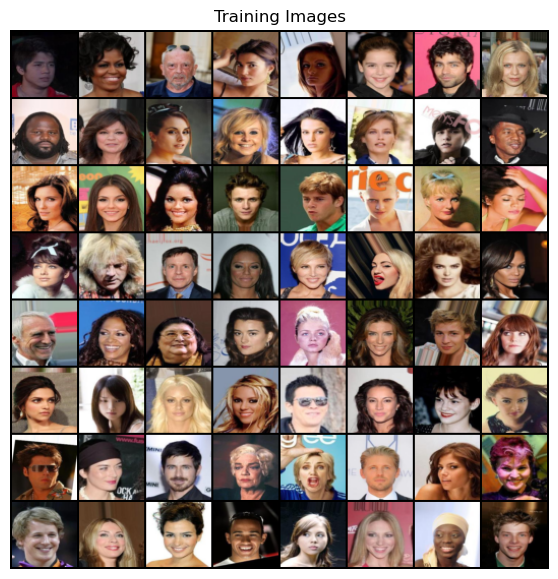

In [9]:
real_batch = next(iter(dataloader))
plt.figure(figsize=(7,7))
plt.axis("off")
plt.title("Training Images")
plt.imshow(np.transpose(vutils.make_grid(real_batch[0].to(device)[:64], padding=2, normalize=True).cpu(),(1,2,0)))

In [10]:
gen = Generator(Z_DIM, CHANNELS_IMG, FEATURES_GEN).to(device)
disc = Discriminator(CHANNELS_IMG, FEATURES_DISC).to(device)
initialize_weights(gen)
initialize_weights(disc)

In [ ]:
opt_gen = optim.Adam(gen.parameters(), lr=LEARNING_RATE, betas=(0.5, 0.999))
opt_disc = optim.Adam(disc.parameters(), lr=LEARNING_RATE, betas=(0.5, 0.999))
criterion = nn.BCELoss()

fixed_noise = torch.randn(32, Z_DIM, 1, 1).to(device)

In [16]:
def show_tensor_images(image_tensor, num_images=32, size=(1, 64, 64)):
    '''
    Function for visualizing images: Given a tensor of images, number of images, and
    size per image, plots and prints the images in an uniform grid.
    '''
    image_tensor = (image_tensor + 1) / 2
    image_unflat = image_tensor.detach().cpu()
    image_grid = make_grid(image_unflat[:num_images], nrow=4)
    plt.imshow(image_grid.permute(1, 2, 0).squeeze())
    plt.show()

Epoch [0/5] Batch 0/1583                   Loss D: 0.6883, loss G: 0.8009


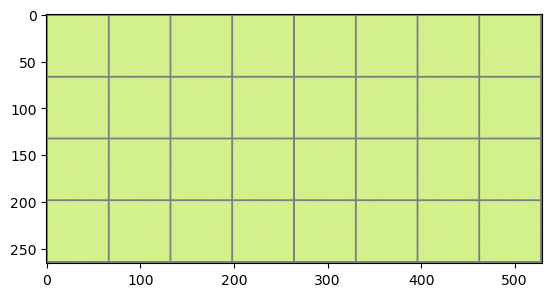

Epoch [0/5] Batch 50/1583                   Loss D: 0.0524, loss G: 2.9343


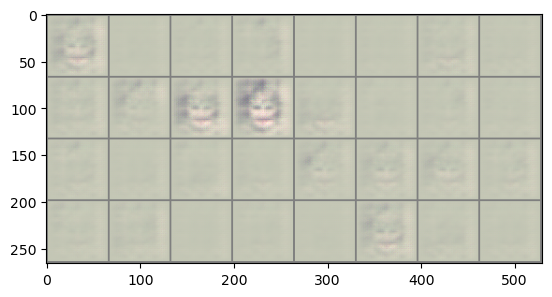

Epoch [0/5] Batch 100/1583                   Loss D: 0.0205, loss G: 4.0844


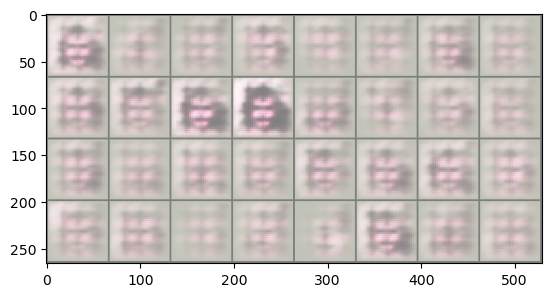

Epoch [0/5] Batch 150/1583                   Loss D: 0.5814, loss G: 1.6201


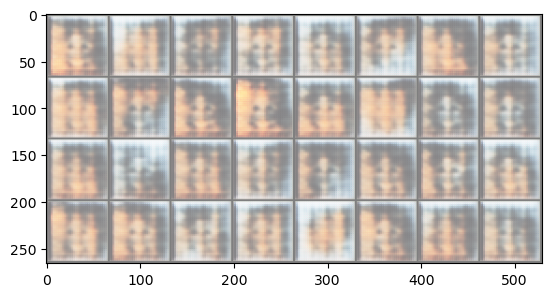

Epoch [0/5] Batch 200/1583                   Loss D: 0.4982, loss G: 1.9351


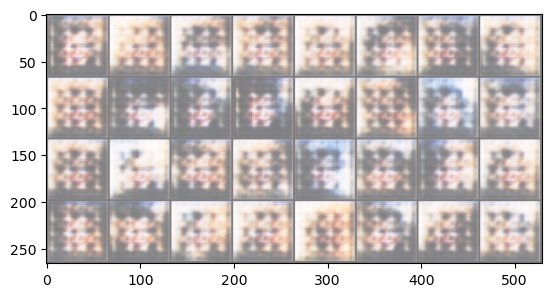

Epoch [0/5] Batch 250/1583                   Loss D: 0.4699, loss G: 1.8199


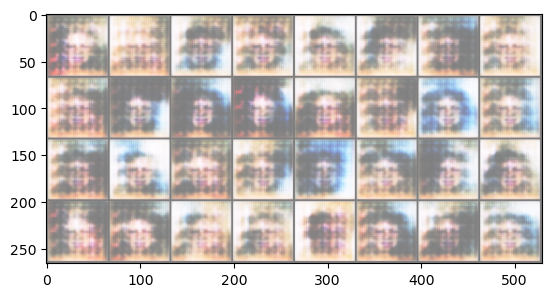

Epoch [0/5] Batch 300/1583                   Loss D: 0.5743, loss G: 1.6080


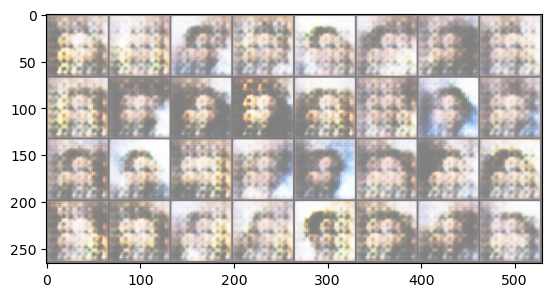

Epoch [0/5] Batch 350/1583                   Loss D: 0.6018, loss G: 2.1820


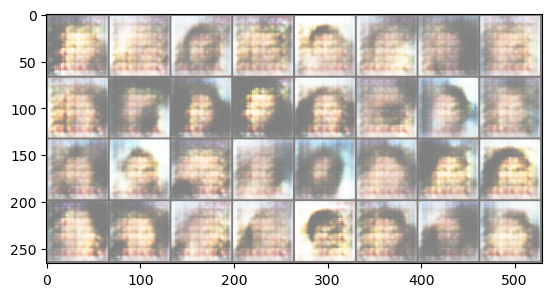

Epoch [0/5] Batch 400/1583                   Loss D: 0.5995, loss G: 1.4997


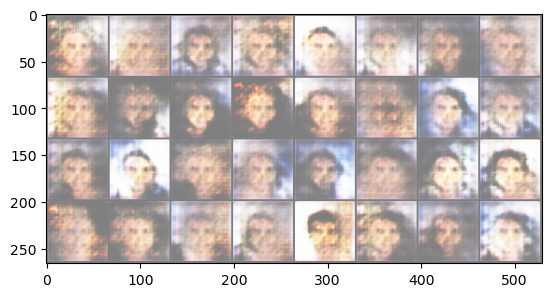

Epoch [0/5] Batch 450/1583                   Loss D: 0.4878, loss G: 1.6670


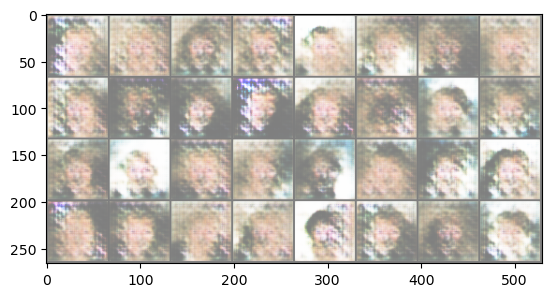

Epoch [0/5] Batch 500/1583                   Loss D: 0.6243, loss G: 1.7783


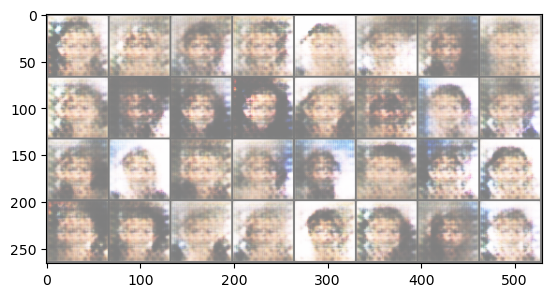

Epoch [0/5] Batch 550/1583                   Loss D: 0.5249, loss G: 1.4046


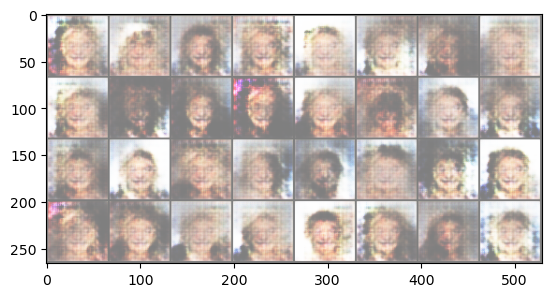

Epoch [0/5] Batch 600/1583                   Loss D: 0.5267, loss G: 1.9008


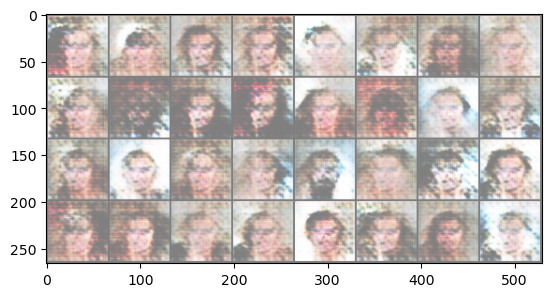

Epoch [0/5] Batch 650/1583                   Loss D: 0.4910, loss G: 1.6158


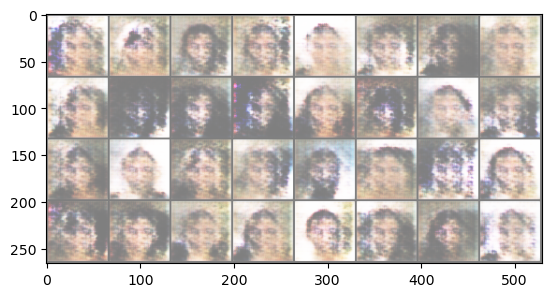

Epoch [0/5] Batch 700/1583                   Loss D: 0.5452, loss G: 1.5407


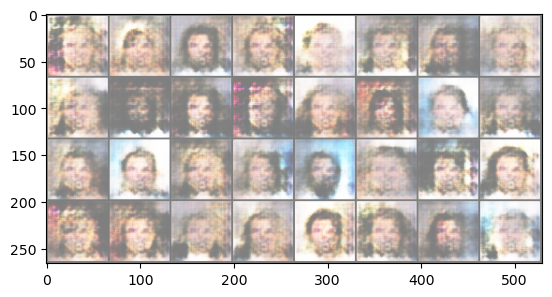

Epoch [0/5] Batch 750/1583                   Loss D: 0.5411, loss G: 1.5792


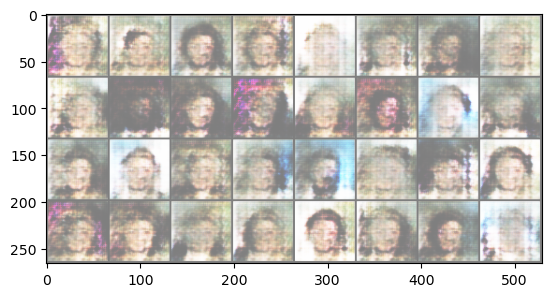

Epoch [0/5] Batch 800/1583                   Loss D: 0.6267, loss G: 1.9069


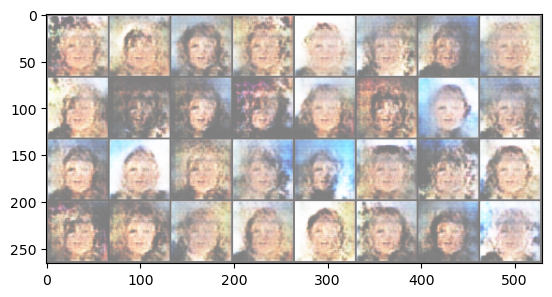

Epoch [0/5] Batch 850/1583                   Loss D: 0.5494, loss G: 1.9852


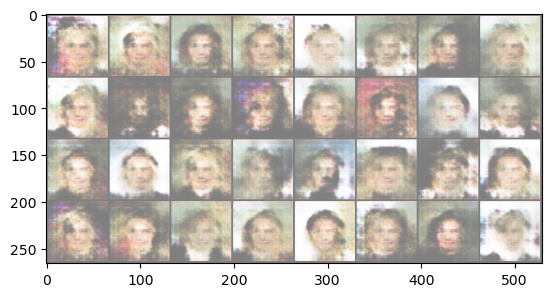

Epoch [0/5] Batch 900/1583                   Loss D: 0.4917, loss G: 1.5564


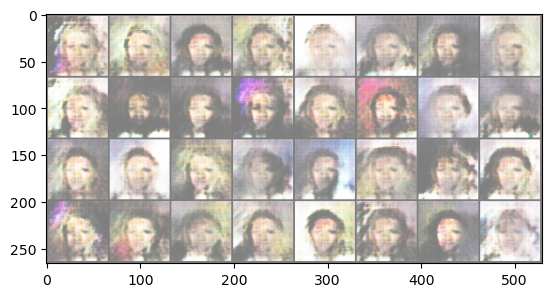

Epoch [0/5] Batch 950/1583                   Loss D: 0.5459, loss G: 1.9225


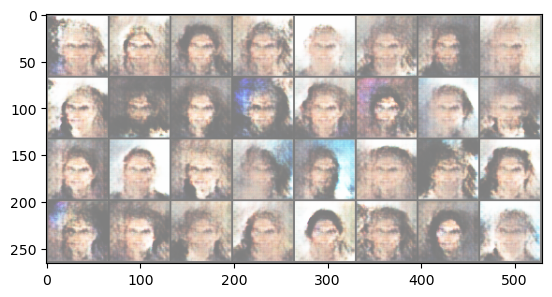

Epoch [0/5] Batch 1000/1583                   Loss D: 0.5958, loss G: 1.7544


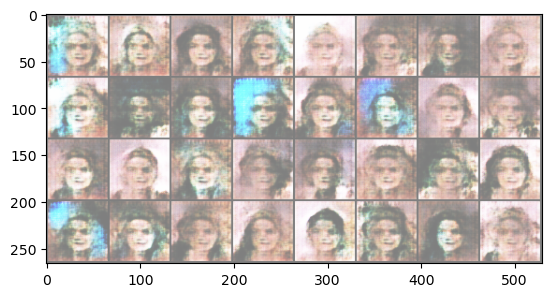

Epoch [0/5] Batch 1050/1583                   Loss D: 0.5391, loss G: 1.5468


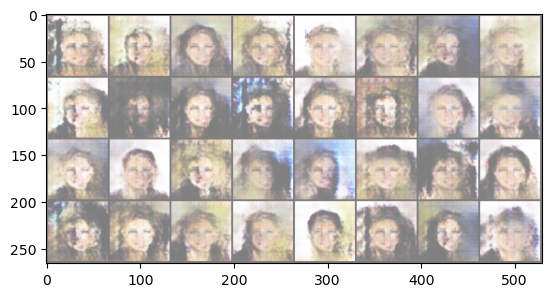

Epoch [0/5] Batch 1100/1583                   Loss D: 0.5307, loss G: 1.9729


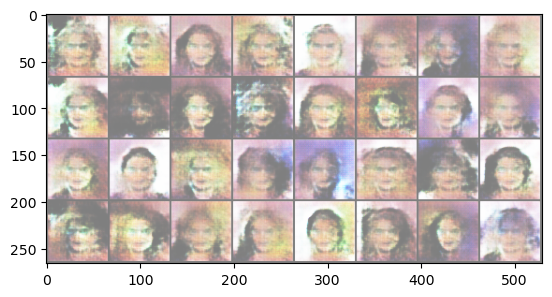

Epoch [0/5] Batch 1150/1583                   Loss D: 0.6574, loss G: 2.4385


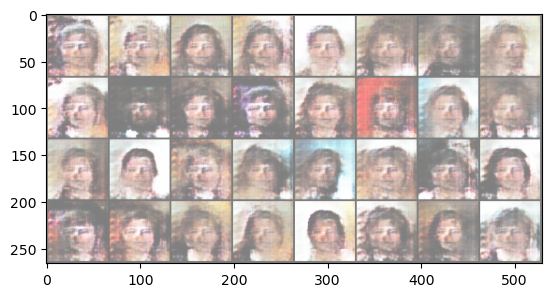

Epoch [0/5] Batch 1200/1583                   Loss D: 0.6529, loss G: 1.4821


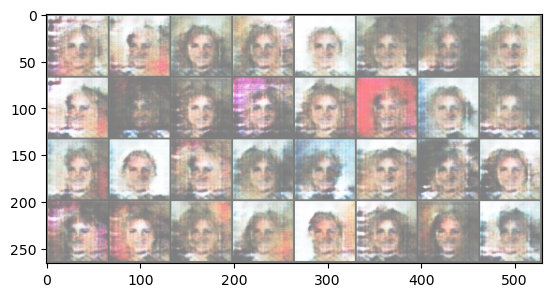

Epoch [0/5] Batch 1250/1583                   Loss D: 0.4647, loss G: 1.9265


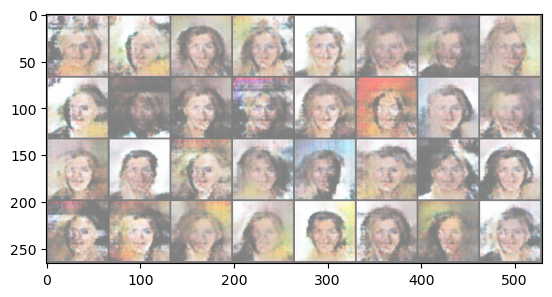

Epoch [0/5] Batch 1300/1583                   Loss D: 0.4139, loss G: 2.0265


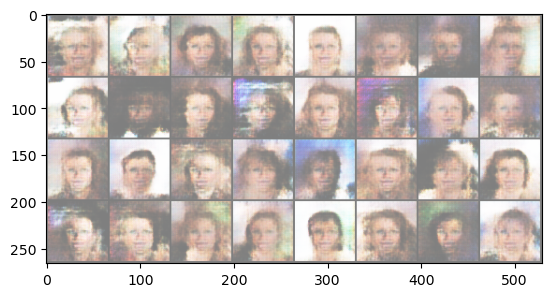

Epoch [0/5] Batch 1350/1583                   Loss D: 0.9442, loss G: 3.4793


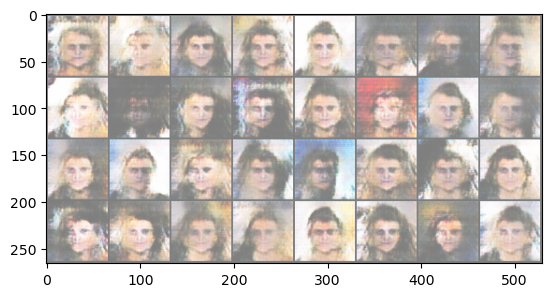

Epoch [0/5] Batch 1400/1583                   Loss D: 0.5333, loss G: 2.6853


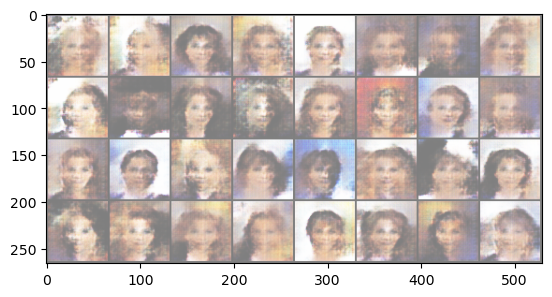

Epoch [0/5] Batch 1450/1583                   Loss D: 0.5394, loss G: 1.4925


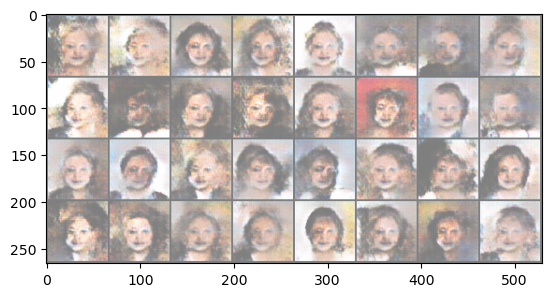

Epoch [0/5] Batch 1500/1583                   Loss D: 0.5287, loss G: 1.3673


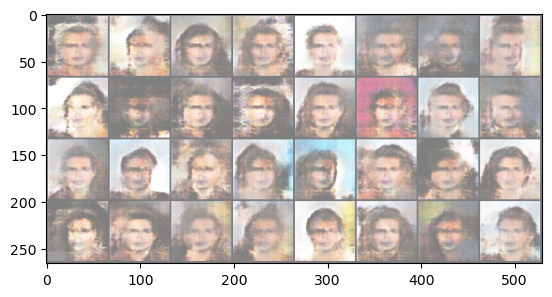

Epoch [0/5] Batch 1550/1583                   Loss D: 0.4638, loss G: 1.9049


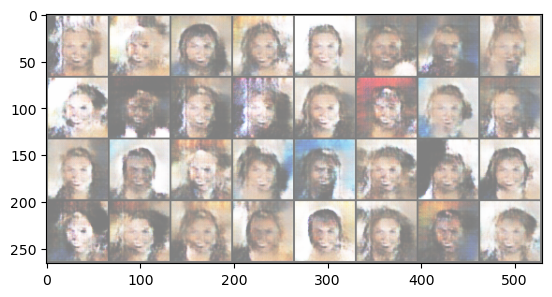

Epoch [1/5] Batch 0/1583                   Loss D: 0.6051, loss G: 1.8598


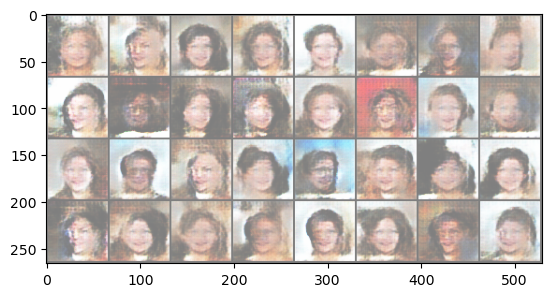

Epoch [1/5] Batch 50/1583                   Loss D: 0.5187, loss G: 1.6438


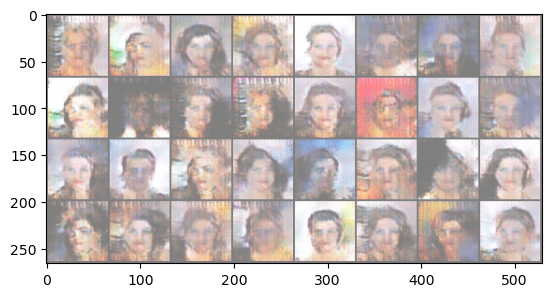

Epoch [1/5] Batch 100/1583                   Loss D: 0.4657, loss G: 1.3365


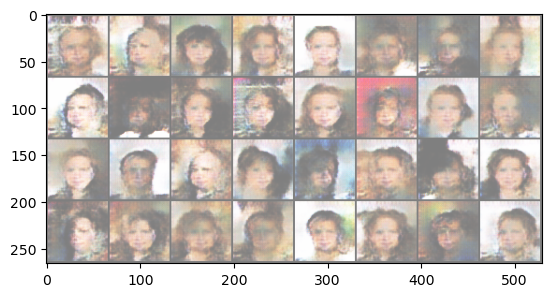

Epoch [1/5] Batch 150/1583                   Loss D: 0.5403, loss G: 1.4325


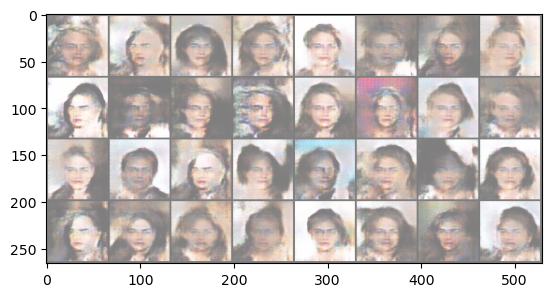

Epoch [1/5] Batch 200/1583                   Loss D: 0.4412, loss G: 1.6832


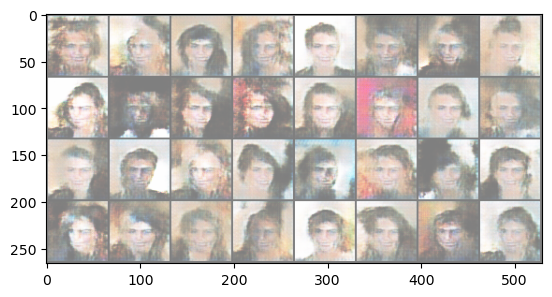

Epoch [1/5] Batch 250/1583                   Loss D: 0.5440, loss G: 2.1484


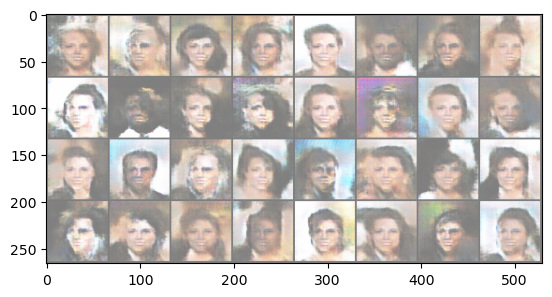

Epoch [1/5] Batch 300/1583                   Loss D: 0.5046, loss G: 1.5238


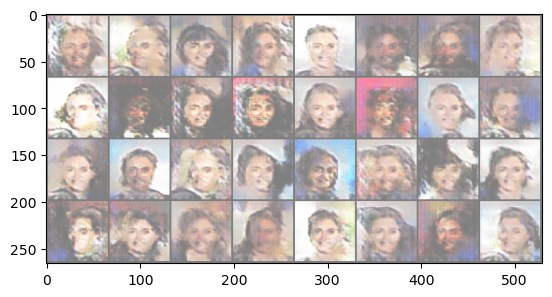

Epoch [1/5] Batch 350/1583                   Loss D: 0.5326, loss G: 1.8956


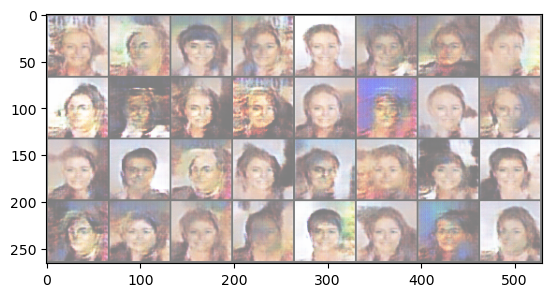

Epoch [1/5] Batch 400/1583                   Loss D: 0.5175, loss G: 1.3822


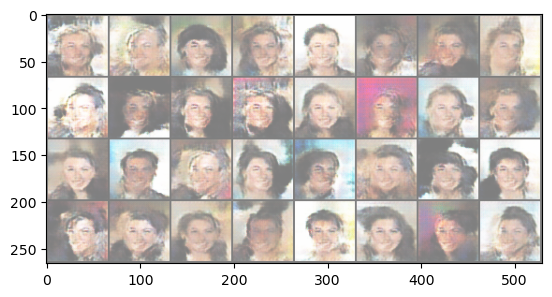

Epoch [1/5] Batch 450/1583                   Loss D: 0.6584, loss G: 2.6718


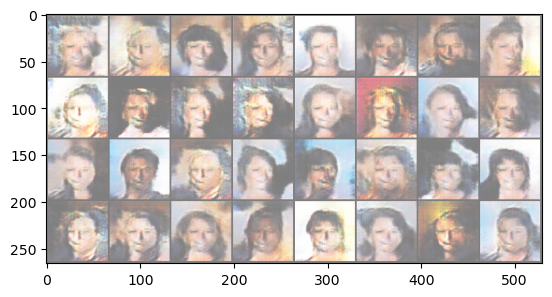

Epoch [1/5] Batch 500/1583                   Loss D: 0.5457, loss G: 1.7695


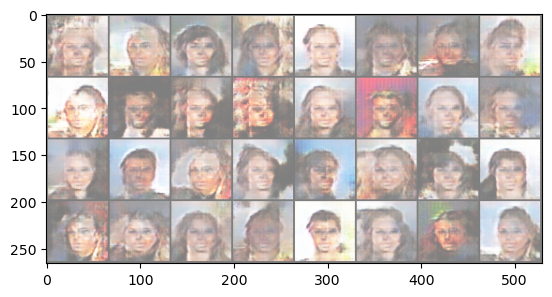

Epoch [1/5] Batch 550/1583                   Loss D: 0.5833, loss G: 1.7530


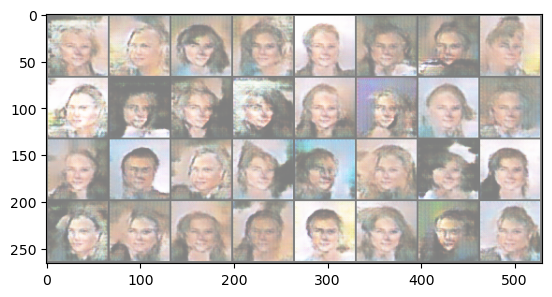

Epoch [1/5] Batch 600/1583                   Loss D: 0.5857, loss G: 0.9616


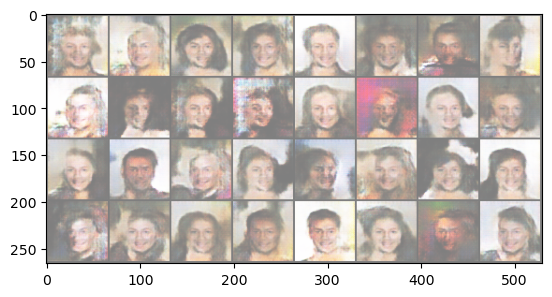

Epoch [1/5] Batch 650/1583                   Loss D: 0.3793, loss G: 2.2543


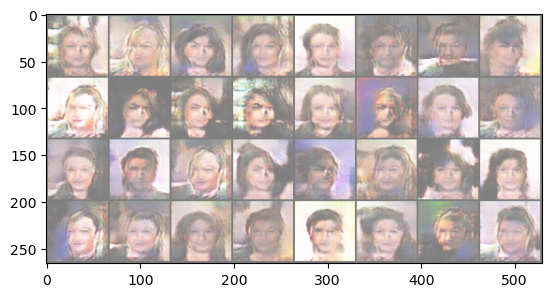

Epoch [1/5] Batch 700/1583                   Loss D: 0.4095, loss G: 1.5966


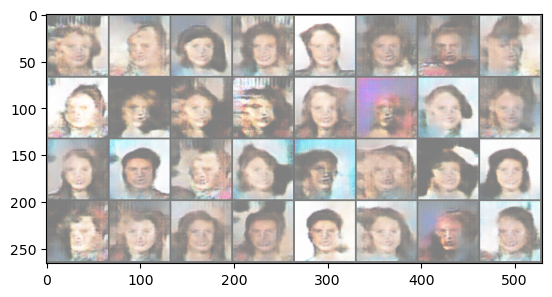

Epoch [1/5] Batch 750/1583                   Loss D: 0.4774, loss G: 1.5611


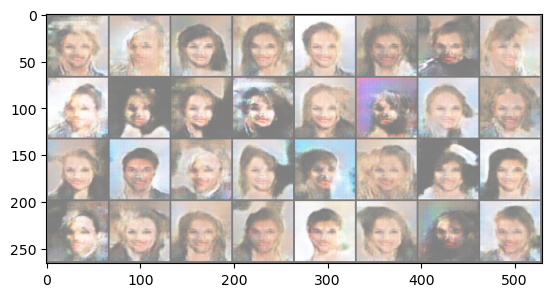

Epoch [1/5] Batch 800/1583                   Loss D: 0.5887, loss G: 0.8912


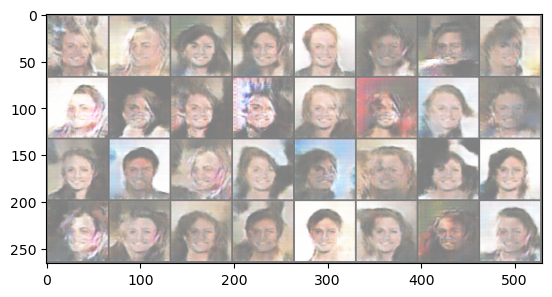

Epoch [1/5] Batch 850/1583                   Loss D: 0.4846, loss G: 1.6950


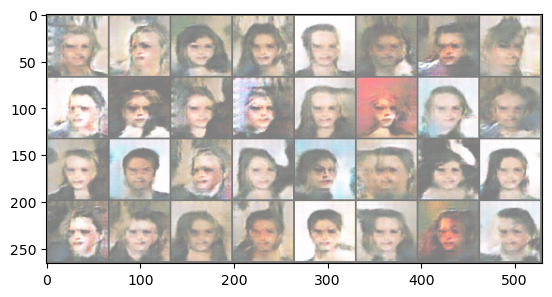

Epoch [1/5] Batch 900/1583                   Loss D: 0.4322, loss G: 1.8230


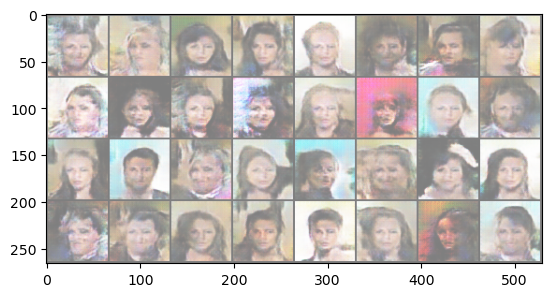

Epoch [1/5] Batch 950/1583                   Loss D: 0.5334, loss G: 2.1356


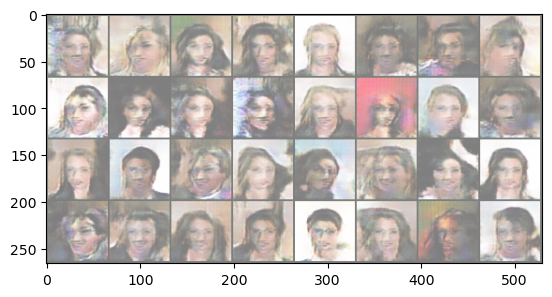

Epoch [1/5] Batch 1000/1583                   Loss D: 0.4644, loss G: 2.2005


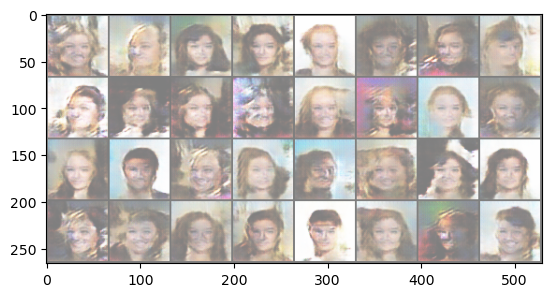

Epoch [1/5] Batch 1050/1583                   Loss D: 0.4752, loss G: 1.3513


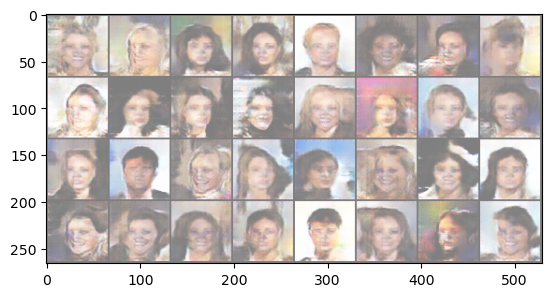

Epoch [1/5] Batch 1100/1583                   Loss D: 0.5173, loss G: 1.6587


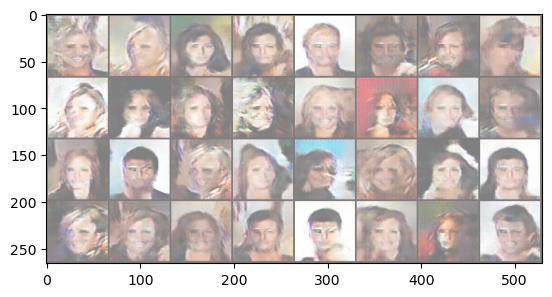

Epoch [1/5] Batch 1150/1583                   Loss D: 0.6504, loss G: 3.1402


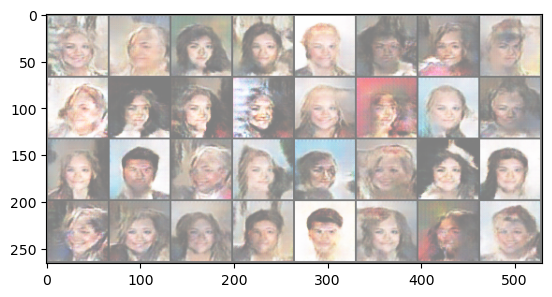

Epoch [1/5] Batch 1200/1583                   Loss D: 0.4219, loss G: 1.8074


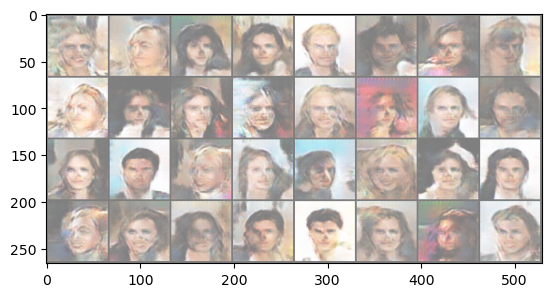

Epoch [1/5] Batch 1250/1583                   Loss D: 0.4710, loss G: 2.3506


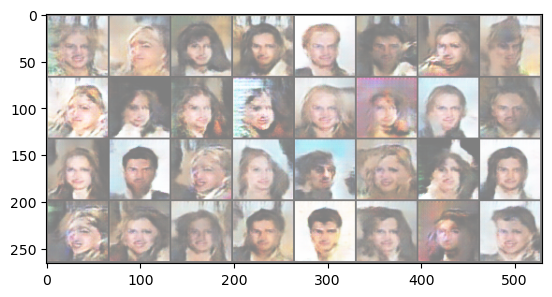

Epoch [1/5] Batch 1300/1583                   Loss D: 0.4893, loss G: 1.6298


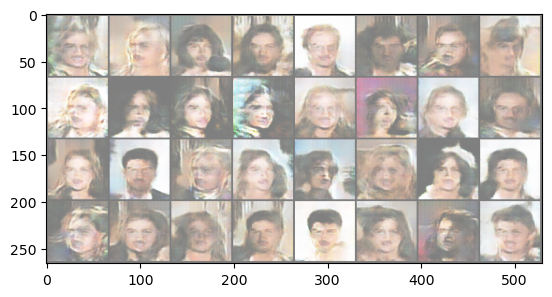

Epoch [1/5] Batch 1350/1583                   Loss D: 0.4573, loss G: 2.1320


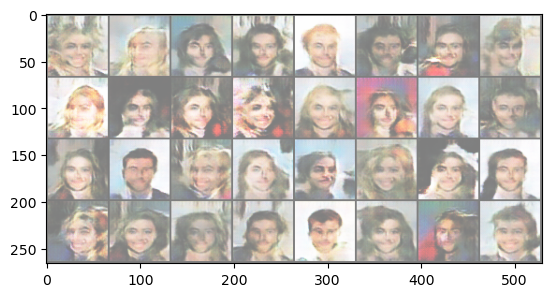

Epoch [1/5] Batch 1400/1583                   Loss D: 0.4649, loss G: 1.4542


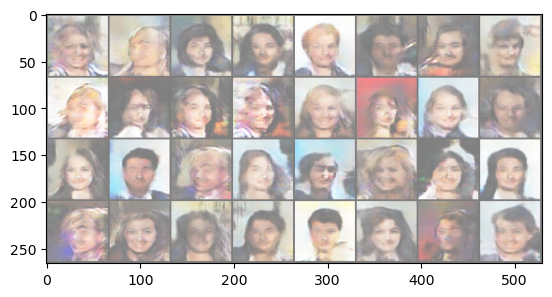

Epoch [1/5] Batch 1450/1583                   Loss D: 0.5292, loss G: 1.8587


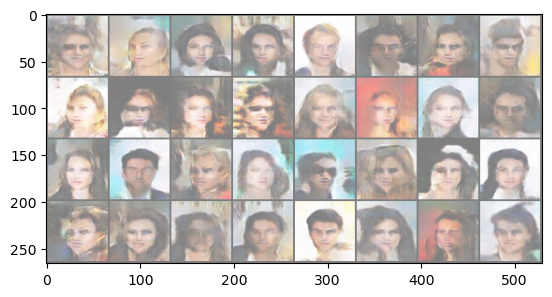

Epoch [1/5] Batch 1500/1583                   Loss D: 0.6006, loss G: 0.9334


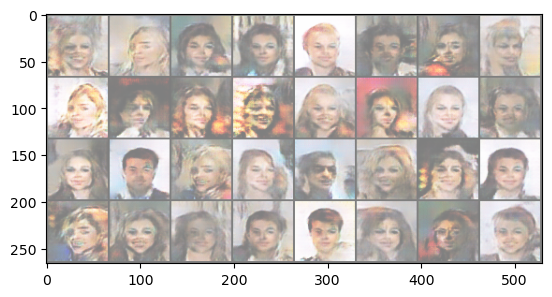

Epoch [1/5] Batch 1550/1583                   Loss D: 0.5772, loss G: 2.7657


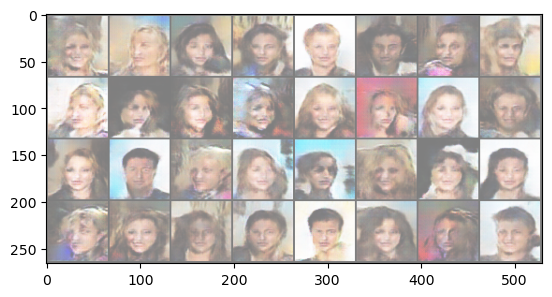

Epoch [2/5] Batch 0/1583                   Loss D: 0.4888, loss G: 1.8264


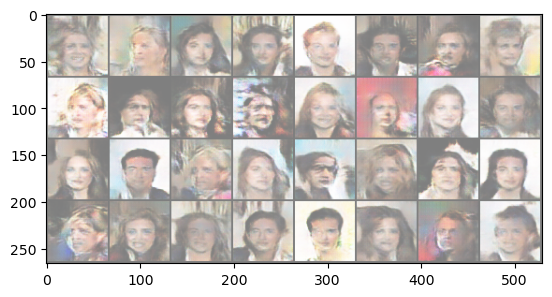

Epoch [2/5] Batch 50/1583                   Loss D: 0.5950, loss G: 1.9563


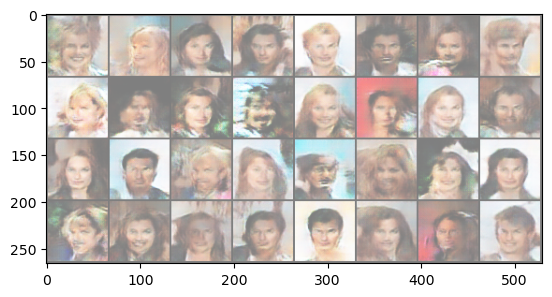

Epoch [2/5] Batch 100/1583                   Loss D: 0.4275, loss G: 1.3427


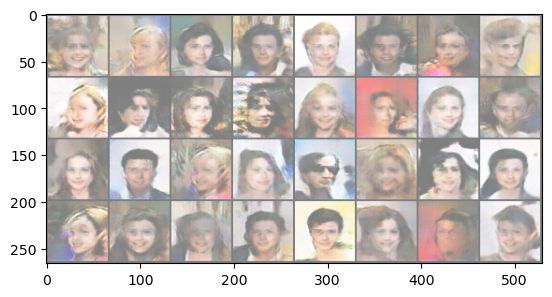

Epoch [2/5] Batch 150/1583                   Loss D: 0.4607, loss G: 1.3093


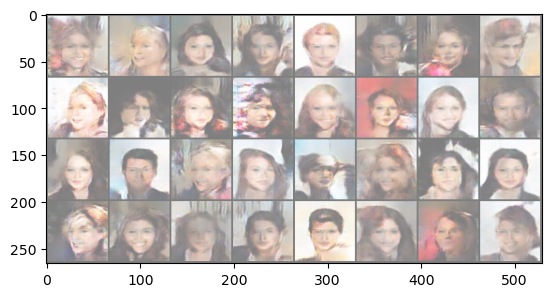

Epoch [2/5] Batch 200/1583                   Loss D: 0.5327, loss G: 1.5728


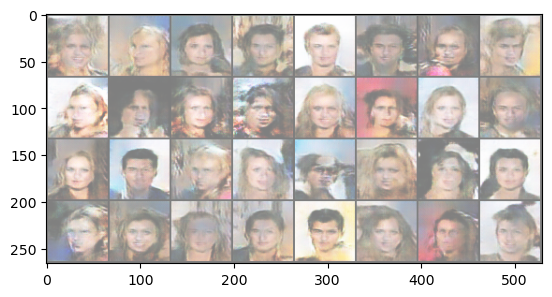

Epoch [2/5] Batch 250/1583                   Loss D: 0.5150, loss G: 1.1930


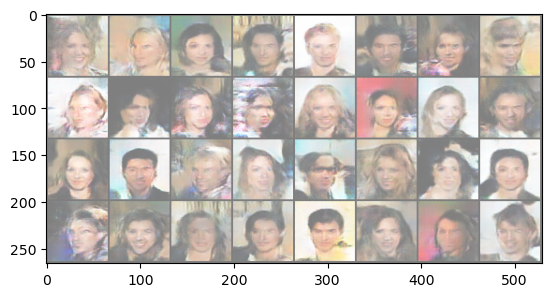

Epoch [2/5] Batch 300/1583                   Loss D: 0.5844, loss G: 0.7825


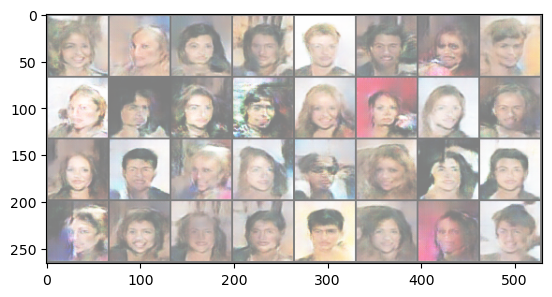

Epoch [2/5] Batch 350/1583                   Loss D: 0.9726, loss G: 0.6639


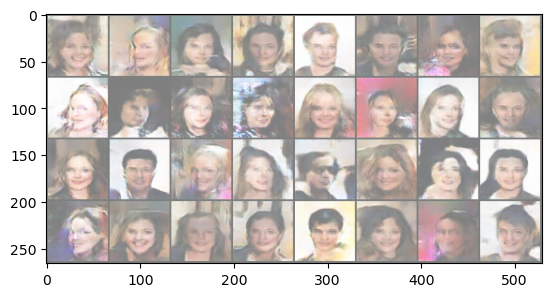

Epoch [2/5] Batch 400/1583                   Loss D: 0.5290, loss G: 1.0084


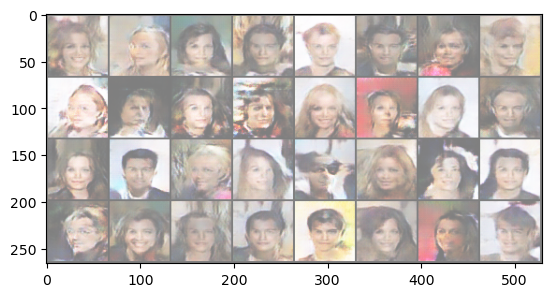

Epoch [2/5] Batch 450/1583                   Loss D: 0.6253, loss G: 2.3278


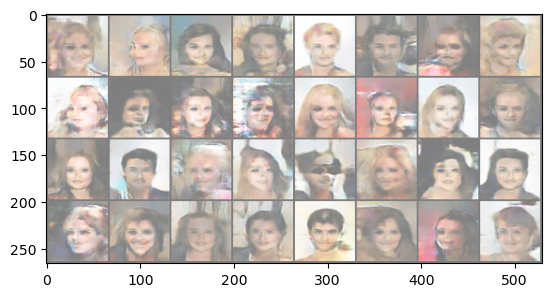

Epoch [2/5] Batch 500/1583                   Loss D: 0.5970, loss G: 1.6840


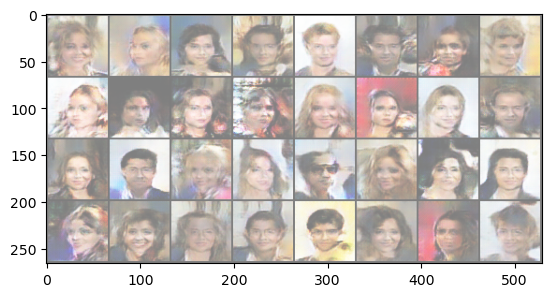

Epoch [2/5] Batch 550/1583                   Loss D: 0.5215, loss G: 1.5434


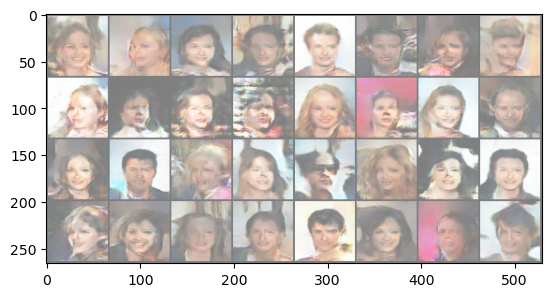

Epoch [2/5] Batch 600/1583                   Loss D: 0.5008, loss G: 1.7325


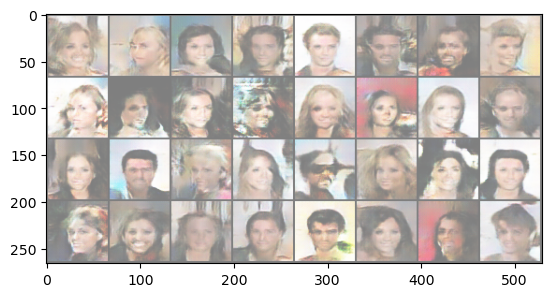

Epoch [2/5] Batch 650/1583                   Loss D: 0.5736, loss G: 1.4514


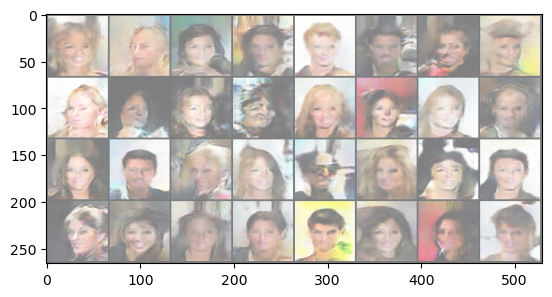

Epoch [2/5] Batch 700/1583                   Loss D: 0.5605, loss G: 1.8727


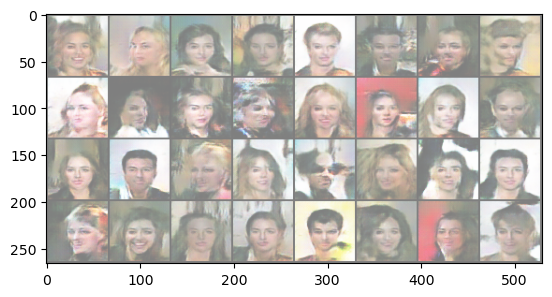

Epoch [2/5] Batch 750/1583                   Loss D: 0.5871, loss G: 1.0624


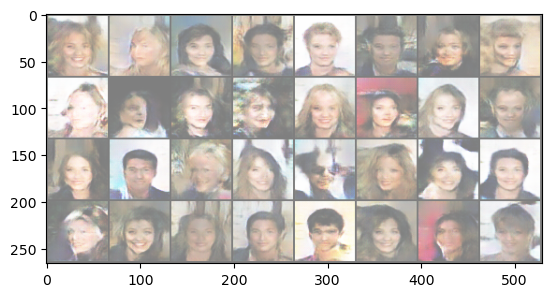

Epoch [2/5] Batch 800/1583                   Loss D: 0.5027, loss G: 1.3512


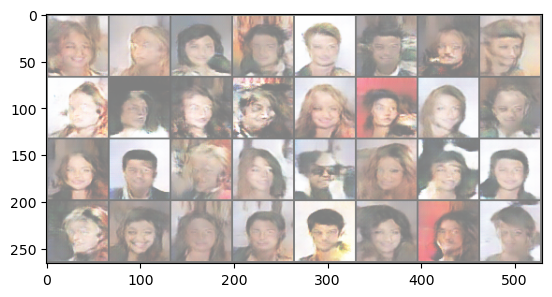

Epoch [2/5] Batch 850/1583                   Loss D: 0.4782, loss G: 1.5659


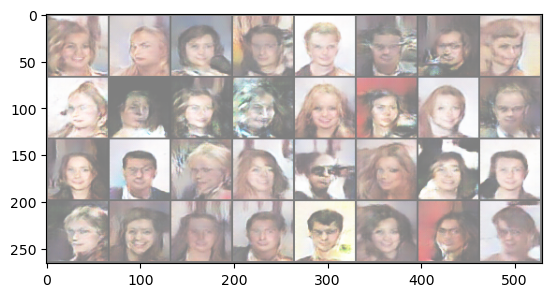

Epoch [2/5] Batch 900/1583                   Loss D: 0.5338, loss G: 2.2054


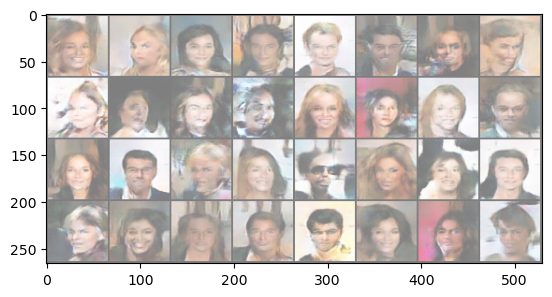

Epoch [2/5] Batch 950/1583                   Loss D: 0.5222, loss G: 1.6796


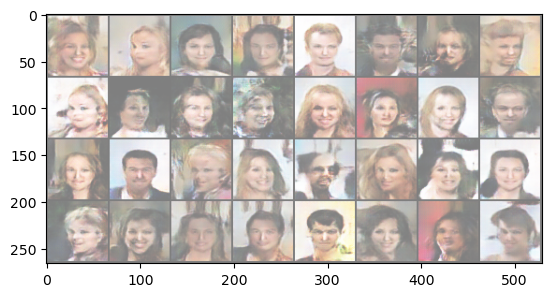

Epoch [2/5] Batch 1000/1583                   Loss D: 0.6617, loss G: 0.6437


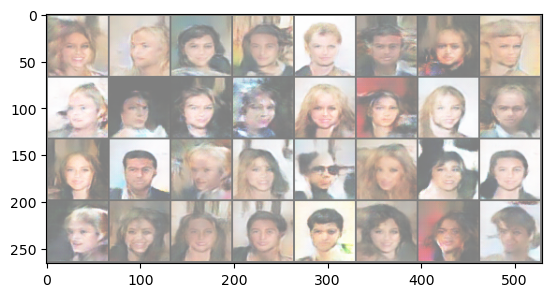

Epoch [2/5] Batch 1050/1583                   Loss D: 0.4474, loss G: 1.7949


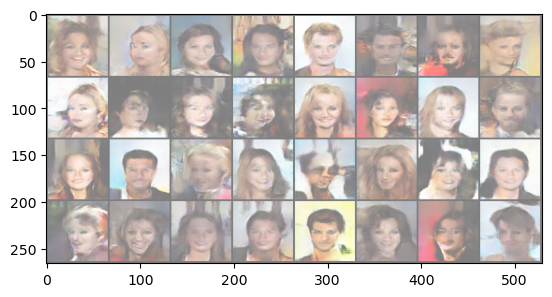

Epoch [2/5] Batch 1100/1583                   Loss D: 0.5058, loss G: 2.0058


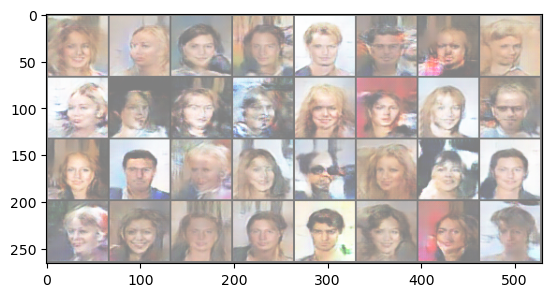

Epoch [2/5] Batch 1150/1583                   Loss D: 0.4625, loss G: 1.5135


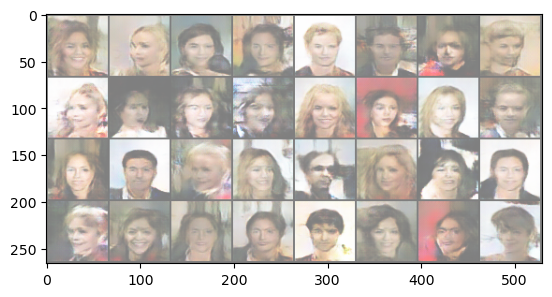

Epoch [2/5] Batch 1200/1583                   Loss D: 0.4813, loss G: 1.2595


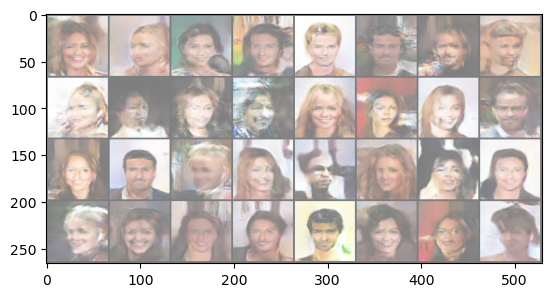

Epoch [2/5] Batch 1250/1583                   Loss D: 0.5903, loss G: 2.5814


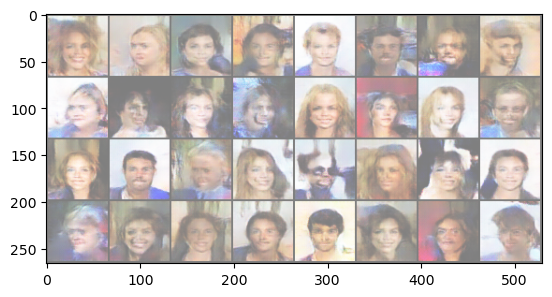

Epoch [2/5] Batch 1300/1583                   Loss D: 0.5372, loss G: 0.9606


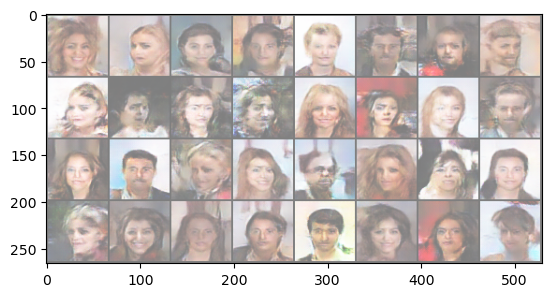

Epoch [2/5] Batch 1350/1583                   Loss D: 0.5449, loss G: 1.1908


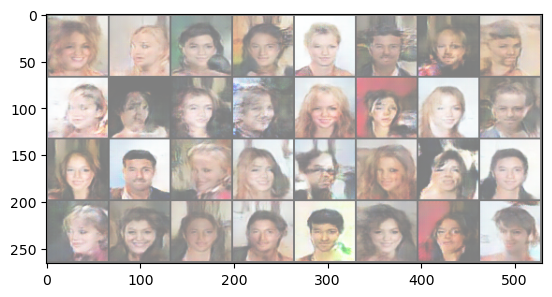

Epoch [2/5] Batch 1400/1583                   Loss D: 0.4659, loss G: 1.3993


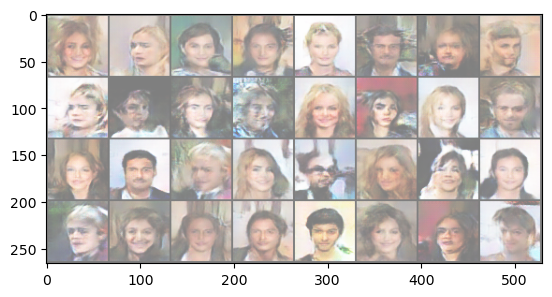

Epoch [2/5] Batch 1450/1583                   Loss D: 0.6323, loss G: 2.5216


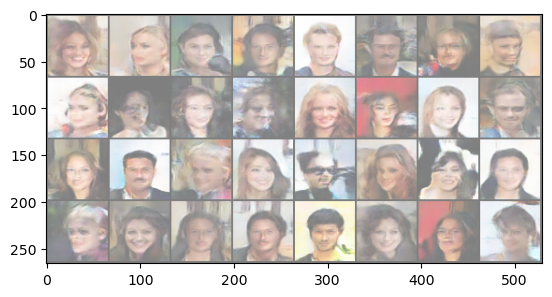

Epoch [2/5] Batch 1500/1583                   Loss D: 0.5194, loss G: 1.1418


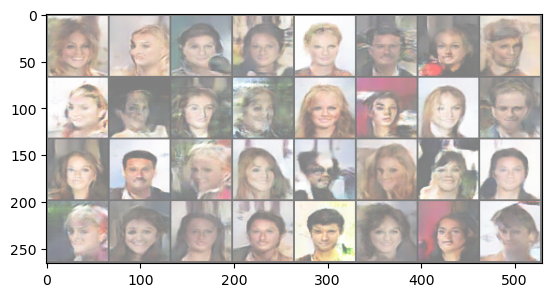

Epoch [2/5] Batch 1550/1583                   Loss D: 0.4772, loss G: 1.3060


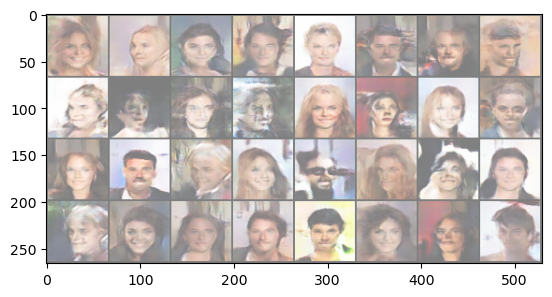

Epoch [3/5] Batch 0/1583                   Loss D: 0.4883, loss G: 1.5369


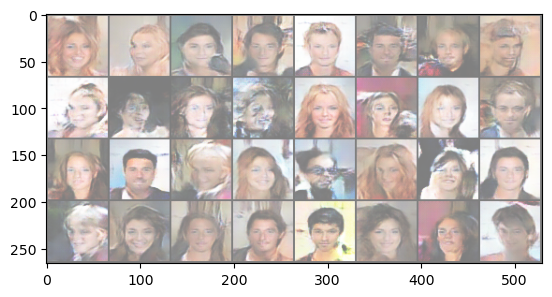

Epoch [3/5] Batch 50/1583                   Loss D: 0.4774, loss G: 1.6457


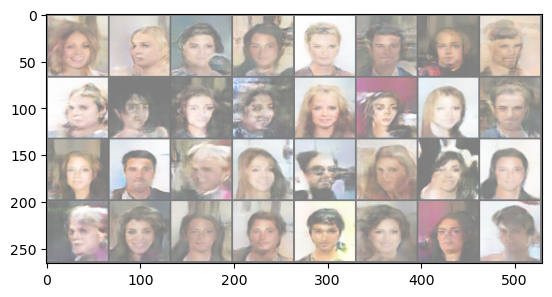

Epoch [3/5] Batch 100/1583                   Loss D: 0.5152, loss G: 1.2425


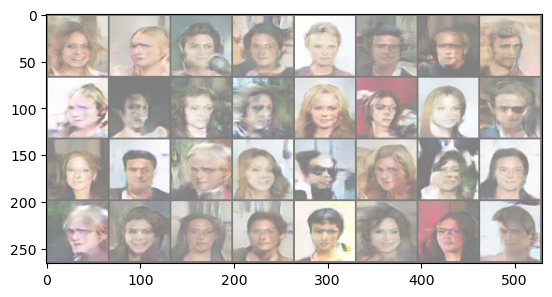

Epoch [3/5] Batch 150/1583                   Loss D: 0.5406, loss G: 2.4062


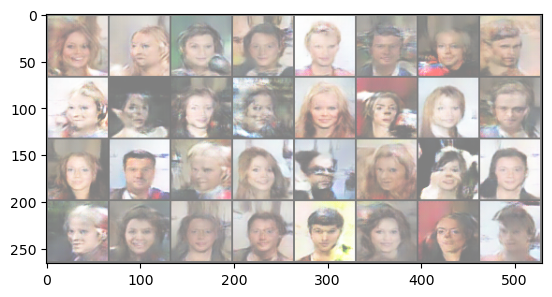

Epoch [3/5] Batch 200/1583                   Loss D: 0.6197, loss G: 0.9587


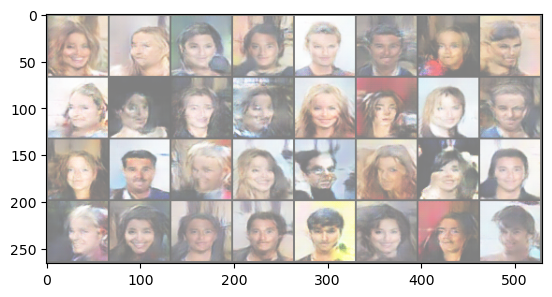

Epoch [3/5] Batch 250/1583                   Loss D: 0.4409, loss G: 1.0409


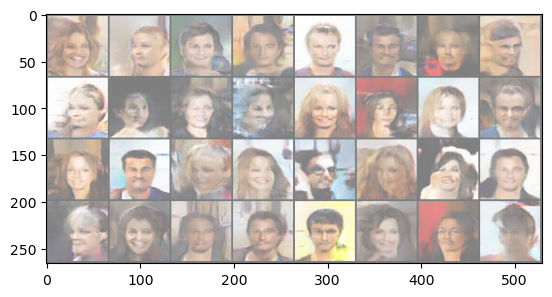

Epoch [3/5] Batch 300/1583                   Loss D: 0.5140, loss G: 1.7893


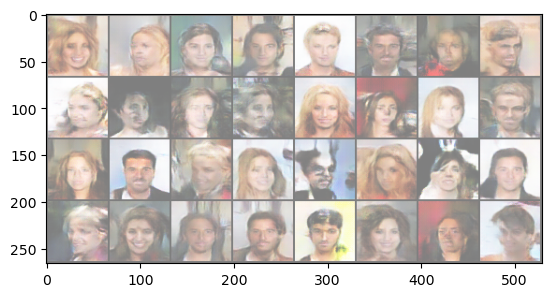

Epoch [3/5] Batch 350/1583                   Loss D: 0.6776, loss G: 1.0114


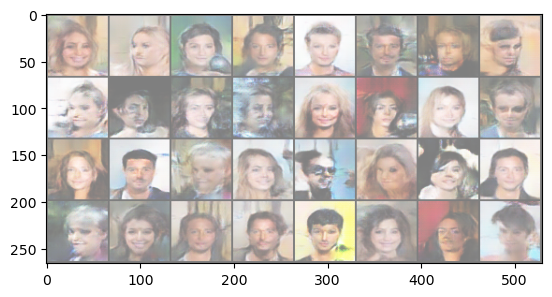

Epoch [3/5] Batch 400/1583                   Loss D: 0.4146, loss G: 1.3379


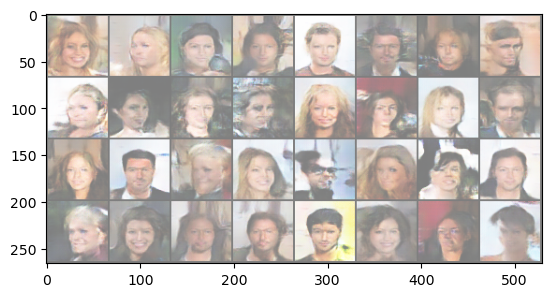

Epoch [3/5] Batch 450/1583                   Loss D: 0.5598, loss G: 1.7229


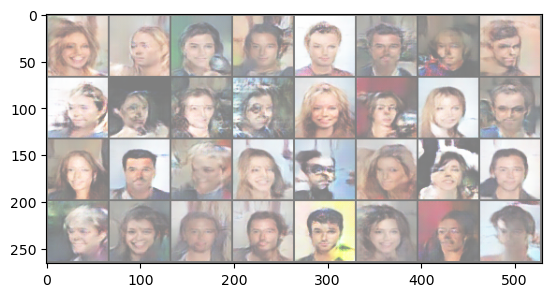

Epoch [3/5] Batch 500/1583                   Loss D: 0.5757, loss G: 1.4671


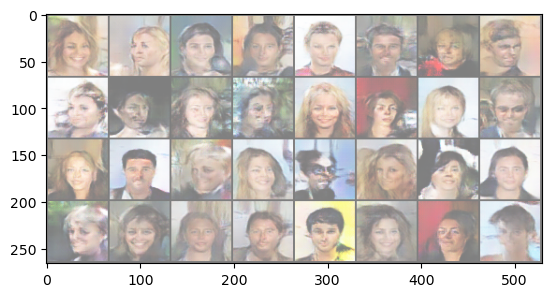

Epoch [3/5] Batch 550/1583                   Loss D: 0.5049, loss G: 1.5985


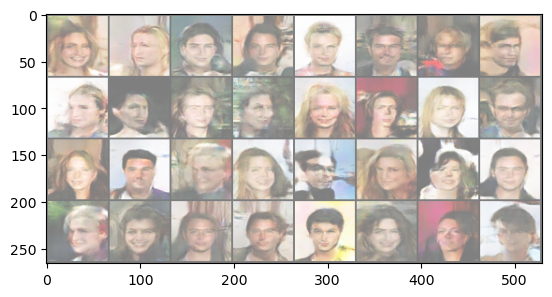

Epoch [3/5] Batch 600/1583                   Loss D: 0.4862, loss G: 1.3387


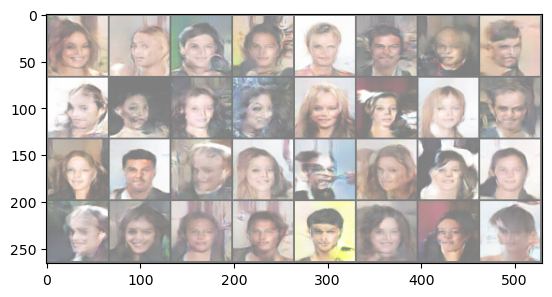

Epoch [3/5] Batch 650/1583                   Loss D: 0.4437, loss G: 1.2262


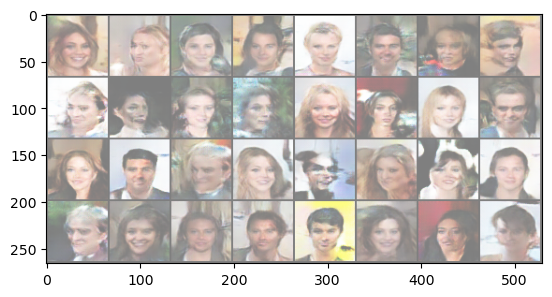

Epoch [3/5] Batch 700/1583                   Loss D: 0.6299, loss G: 1.6063


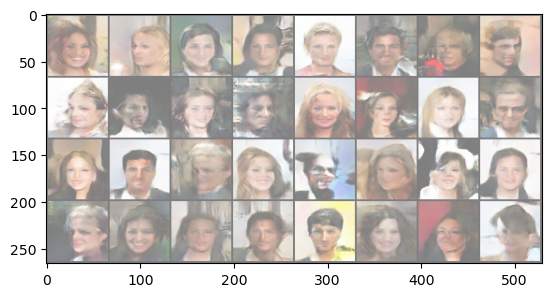

Epoch [3/5] Batch 750/1583                   Loss D: 0.5327, loss G: 1.5635


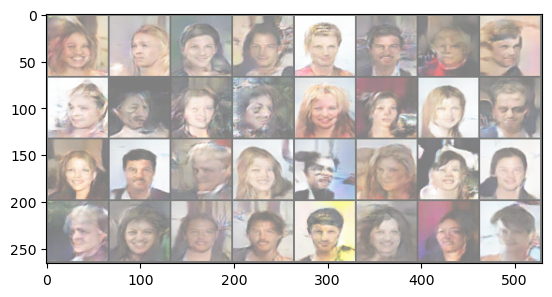

Epoch [3/5] Batch 800/1583                   Loss D: 0.4936, loss G: 1.1545


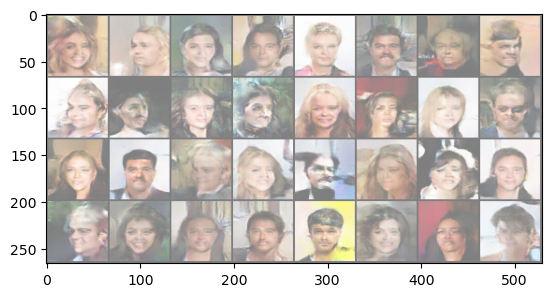

Epoch [3/5] Batch 850/1583                   Loss D: 0.5099, loss G: 1.4728


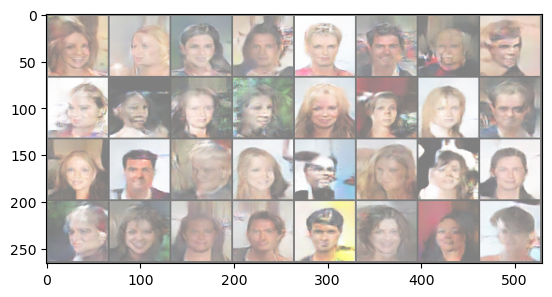

Epoch [3/5] Batch 900/1583                   Loss D: 0.4826, loss G: 1.5823


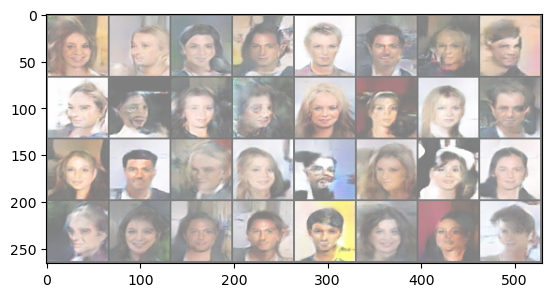

Epoch [3/5] Batch 950/1583                   Loss D: 0.6046, loss G: 2.2924


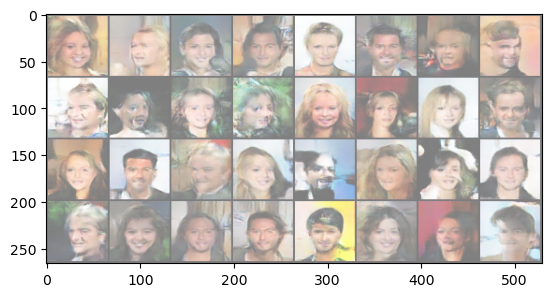

Epoch [3/5] Batch 1000/1583                   Loss D: 0.4816, loss G: 1.2061


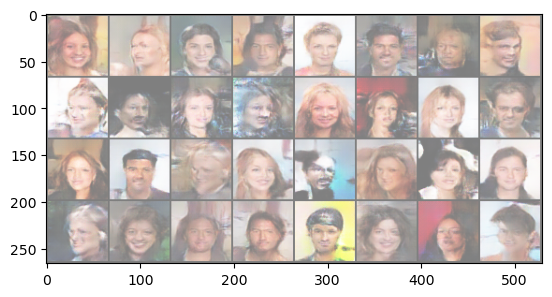

Epoch [3/5] Batch 1050/1583                   Loss D: 0.5095, loss G: 0.8800


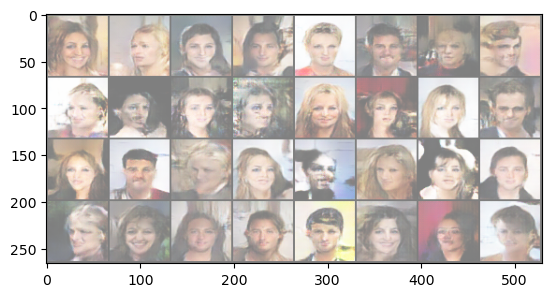

Epoch [3/5] Batch 1100/1583                   Loss D: 0.5444, loss G: 1.2214


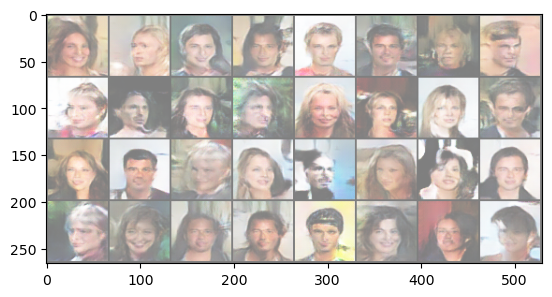

Epoch [3/5] Batch 1150/1583                   Loss D: 0.5455, loss G: 1.8878


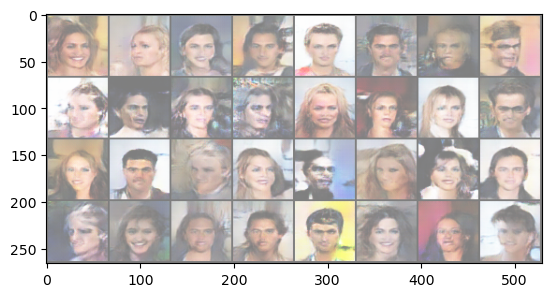

Epoch [3/5] Batch 1200/1583                   Loss D: 0.4551, loss G: 1.4724


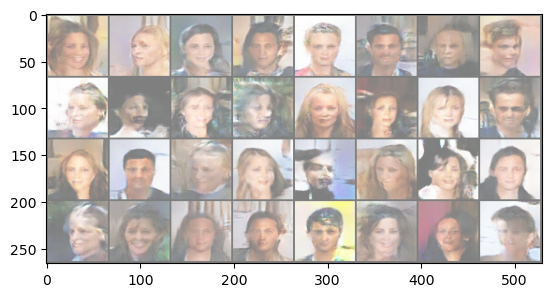

Epoch [3/5] Batch 1250/1583                   Loss D: 0.5446, loss G: 2.3348


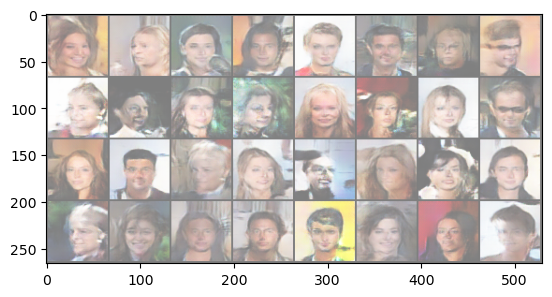

Epoch [3/5] Batch 1300/1583                   Loss D: 0.5209, loss G: 1.9443


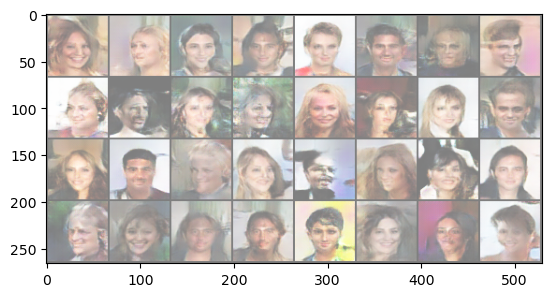

Epoch [3/5] Batch 1350/1583                   Loss D: 0.5592, loss G: 1.2308


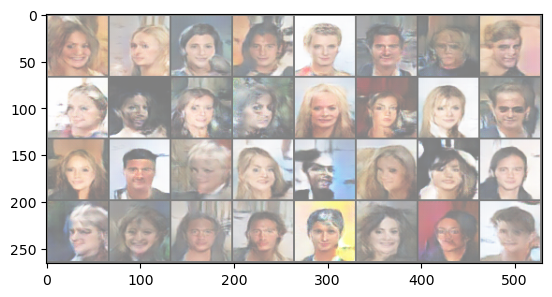

Epoch [3/5] Batch 1400/1583                   Loss D: 0.4583, loss G: 1.2893


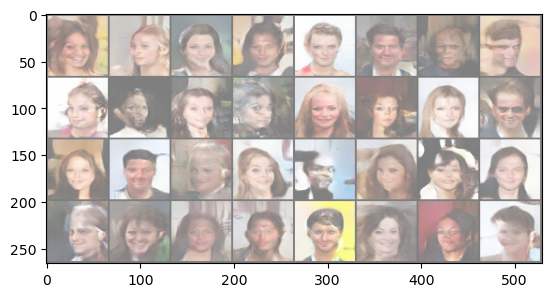

Epoch [3/5] Batch 1450/1583                   Loss D: 0.5320, loss G: 0.8546


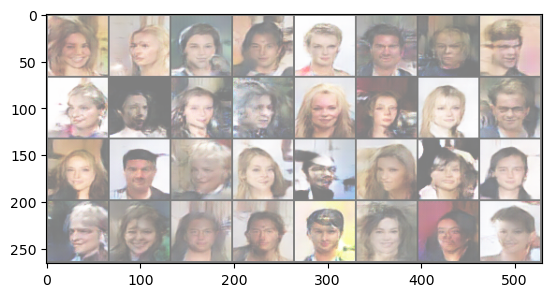

Epoch [3/5] Batch 1500/1583                   Loss D: 0.5285, loss G: 1.3228


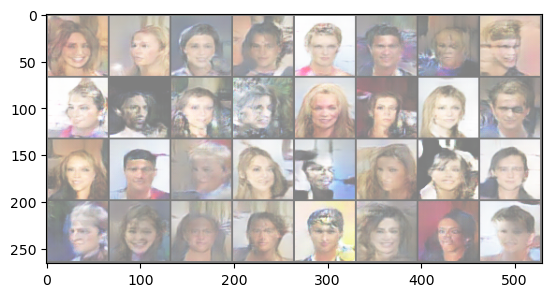

Epoch [3/5] Batch 1550/1583                   Loss D: 0.4547, loss G: 1.5403


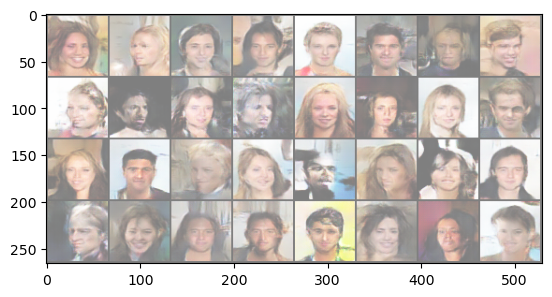

Epoch [4/5] Batch 0/1583                   Loss D: 0.4936, loss G: 2.1096


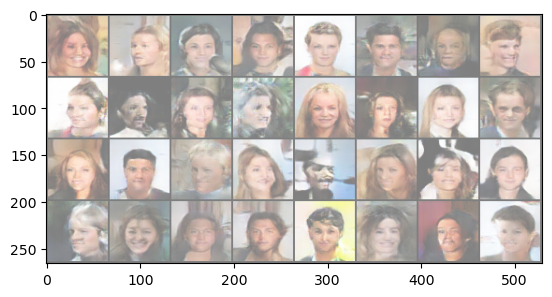

Epoch [4/5] Batch 50/1583                   Loss D: 0.4799, loss G: 0.9966


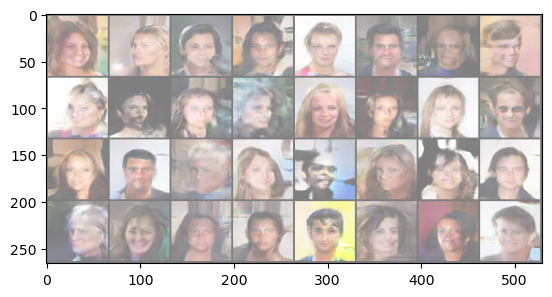

Epoch [4/5] Batch 100/1583                   Loss D: 0.5379, loss G: 1.5475


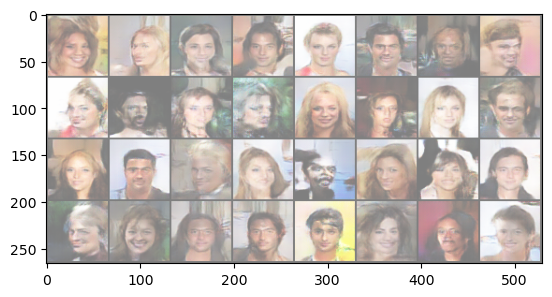

Epoch [4/5] Batch 150/1583                   Loss D: 0.6560, loss G: 0.6180


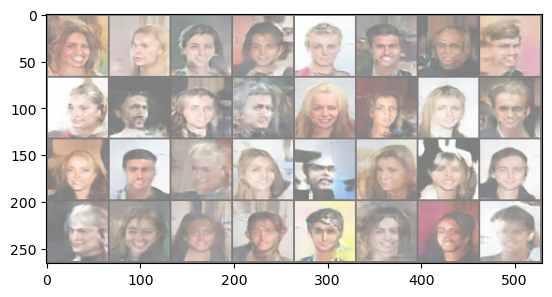

Epoch [4/5] Batch 200/1583                   Loss D: 0.5002, loss G: 1.1161


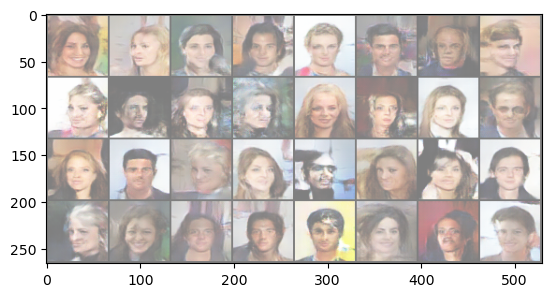

Epoch [4/5] Batch 250/1583                   Loss D: 0.4775, loss G: 1.5425


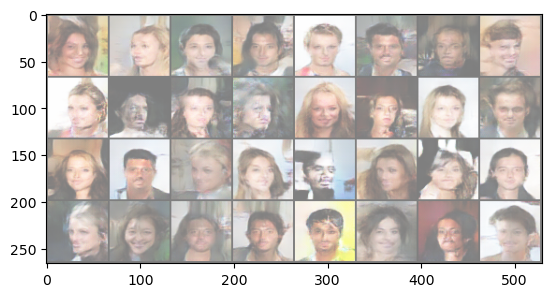

Epoch [4/5] Batch 300/1583                   Loss D: 0.5684, loss G: 1.8161


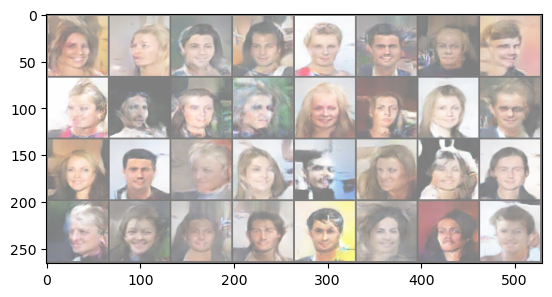

Epoch [4/5] Batch 350/1583                   Loss D: 0.5462, loss G: 2.4774


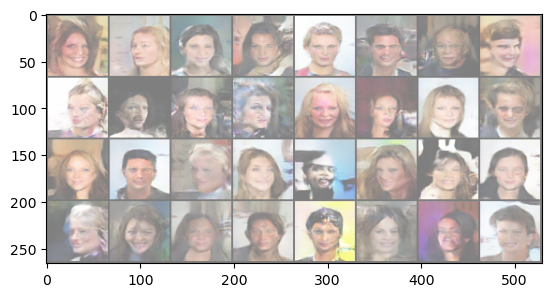

Epoch [4/5] Batch 400/1583                   Loss D: 0.4164, loss G: 0.9826


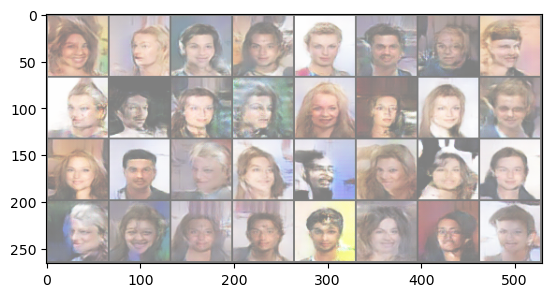

Epoch [4/5] Batch 450/1583                   Loss D: 0.4744, loss G: 1.3971


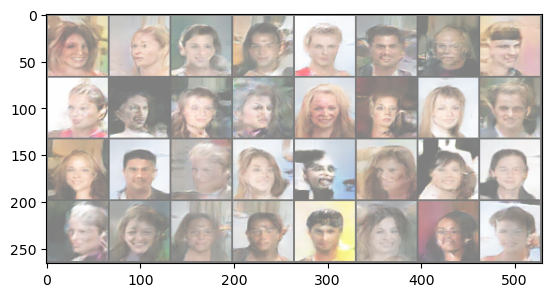

Epoch [4/5] Batch 500/1583                   Loss D: 0.5001, loss G: 1.6812


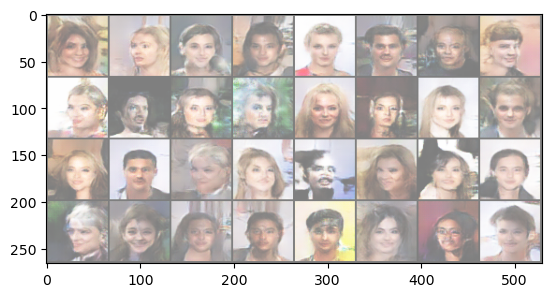

Epoch [4/5] Batch 550/1583                   Loss D: 0.4402, loss G: 1.2172


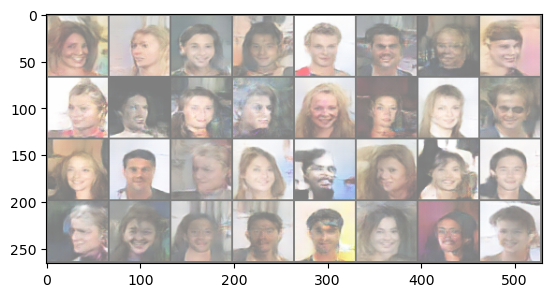

Epoch [4/5] Batch 600/1583                   Loss D: 0.5406, loss G: 0.9714


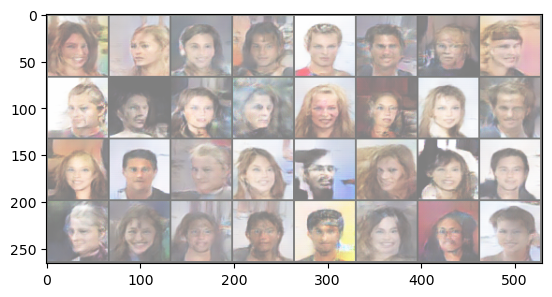

Epoch [4/5] Batch 650/1583                   Loss D: 0.3757, loss G: 1.5217


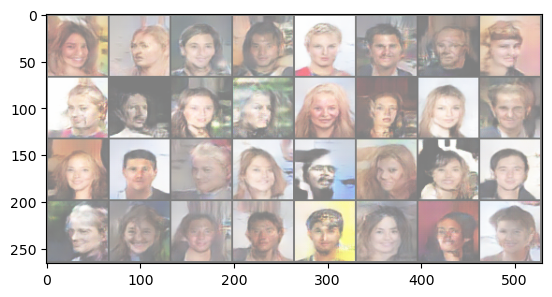

Epoch [4/5] Batch 700/1583                   Loss D: 1.3945, loss G: 4.0312


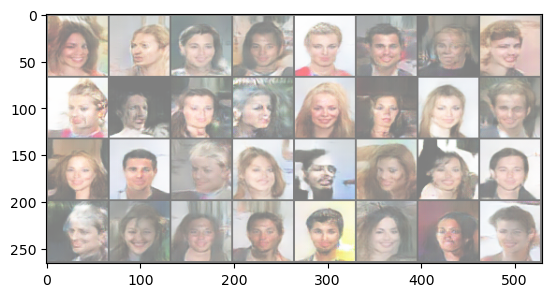

Epoch [4/5] Batch 750/1583                   Loss D: 0.5390, loss G: 1.5133


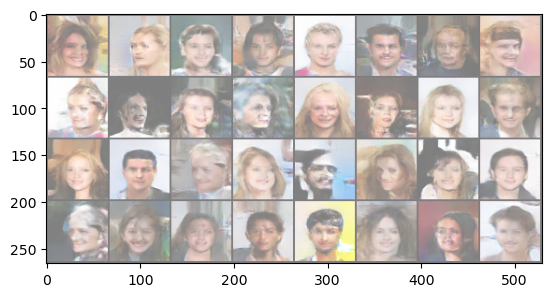

Epoch [4/5] Batch 800/1583                   Loss D: 0.4209, loss G: 1.5299


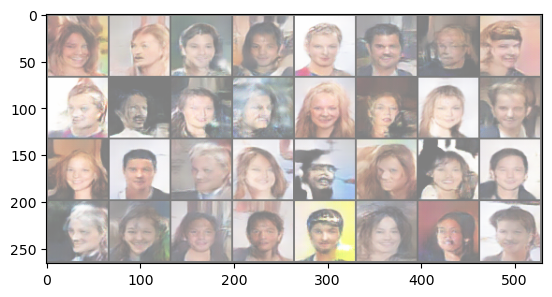

Epoch [4/5] Batch 850/1583                   Loss D: 0.4697, loss G: 1.5717


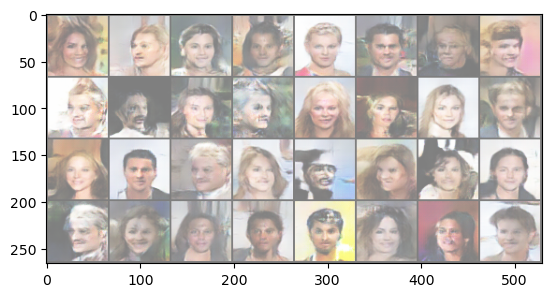

Epoch [4/5] Batch 900/1583                   Loss D: 0.4256, loss G: 1.8578


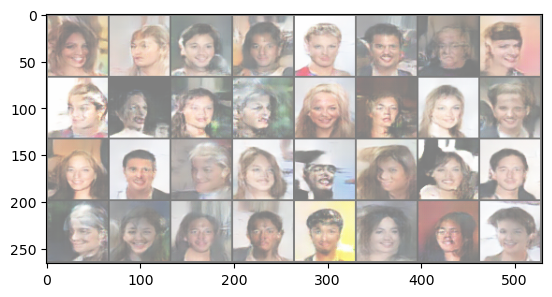

Epoch [4/5] Batch 950/1583                   Loss D: 0.4723, loss G: 1.4662


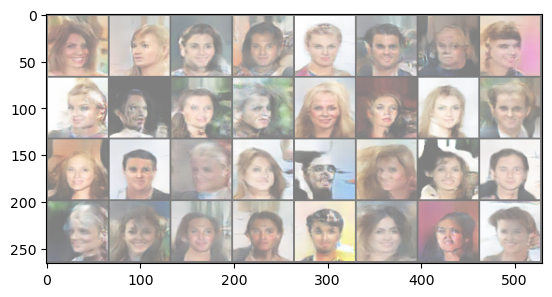

Epoch [4/5] Batch 1000/1583                   Loss D: 0.5302, loss G: 1.3046


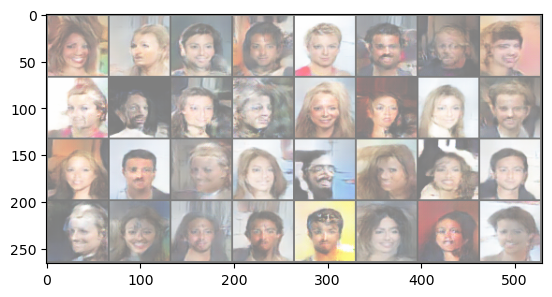

Epoch [4/5] Batch 1050/1583                   Loss D: 0.5003, loss G: 2.1148


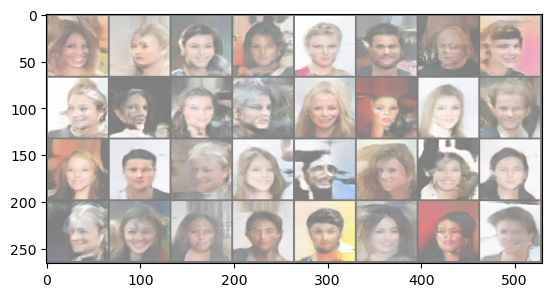

Epoch [4/5] Batch 1100/1583                   Loss D: 0.4764, loss G: 1.4902


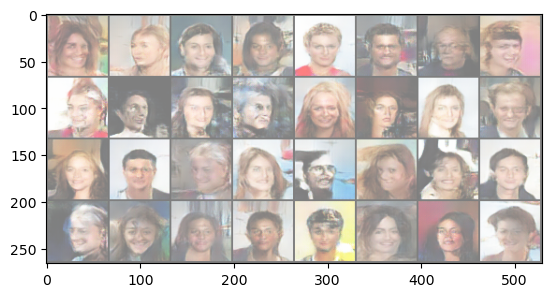

Epoch [4/5] Batch 1150/1583                   Loss D: 0.4863, loss G: 1.1357


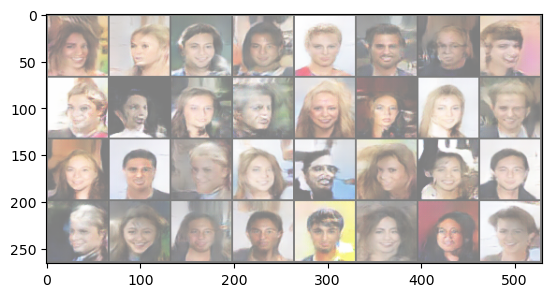

Epoch [4/5] Batch 1200/1583                   Loss D: 0.6115, loss G: 2.7569


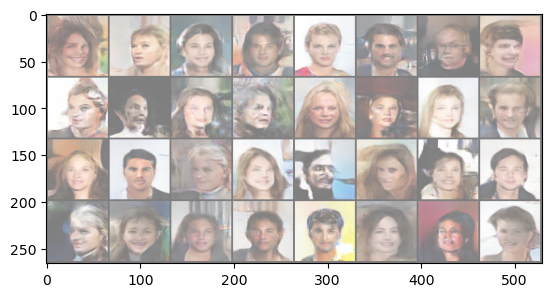

Epoch [4/5] Batch 1250/1583                   Loss D: 0.4934, loss G: 1.6174


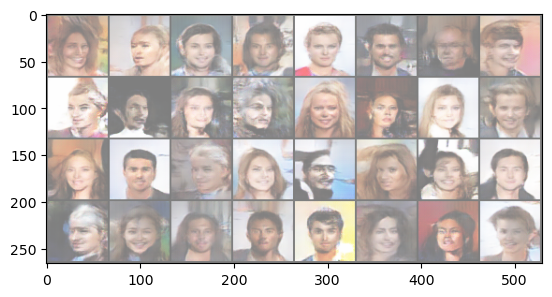

Epoch [4/5] Batch 1300/1583                   Loss D: 0.3987, loss G: 1.4880


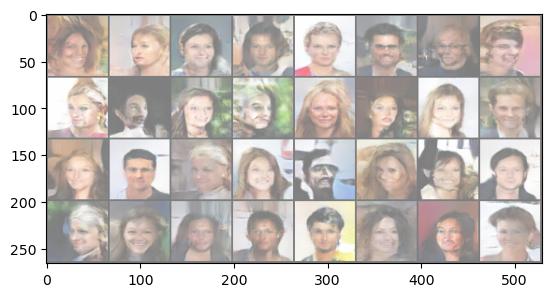

Epoch [4/5] Batch 1350/1583                   Loss D: 1.3581, loss G: 0.6655


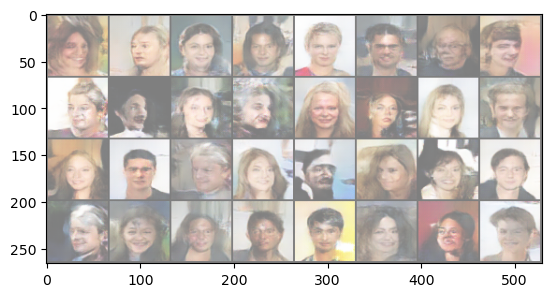

Epoch [4/5] Batch 1400/1583                   Loss D: 0.4825, loss G: 1.1284


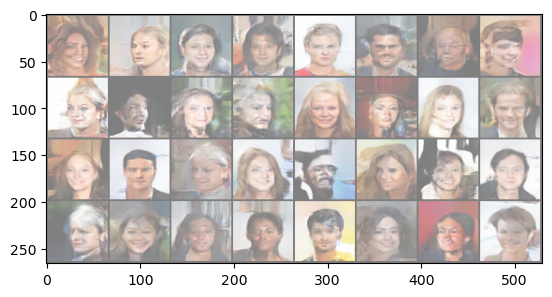

Epoch [4/5] Batch 1450/1583                   Loss D: 0.4038, loss G: 1.6380


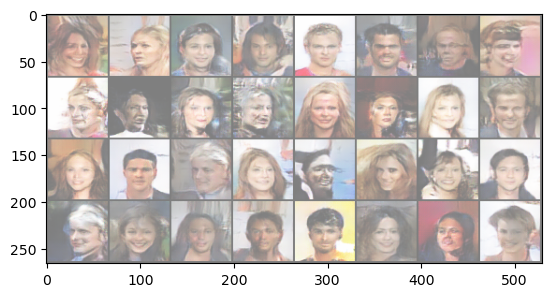

Epoch [4/5] Batch 1500/1583                   Loss D: 0.5073, loss G: 1.2369


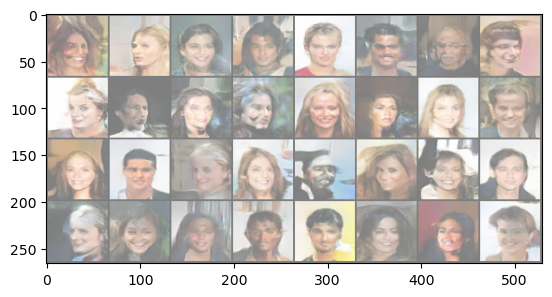

Epoch [4/5] Batch 1550/1583                   Loss D: 0.4005, loss G: 1.7442


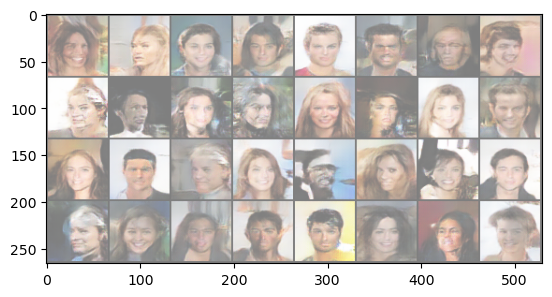

In [33]:
step = 0

gen.train()
disc.train()

for epoch in range(NUM_EPOCHS):
    # Target labels not needed! <3 unsuperviser
    for batch_idx, (real, _ ) in enumerate(dataloader):
        real = real.to(device)
        noise = torch.randn((BATCH_SIZE, Z_DIM, 1, 1)).to(device)
        fake = gen(noise)

        ### Train Discriminator: max log(D(x)) + log(1 - D(G(z)))
        disc_real = disc(real).reshape(-1)
        loss_disc_real = criterion(disc_real, torch.ones_like(disc_real))
        disc_fake = disc(fake.detach()).reshape(-1)
        loss_disc_fake = criterion(disc_fake, torch.zeros_like(disc_fake))
        loss_disc = (loss_disc_real + loss_disc_fake) / 2
        disc.zero_grad()
        loss_disc.backward()
        opt_disc.step()

        ### Train Generator: min log(1 - D(G(z))) <-> max log(D(G(z))
        output = disc(fake).reshape(-1)
        loss_gen = criterion(output, torch.ones_like(output))
        gen.zero_grad()
        loss_gen.backward()
        opt_gen.step()

        # Print losses occasionally and print to tensorboard
        if batch_idx % 50 == 0:
            print(
                f"Epoch [{epoch}/{NUM_EPOCHS}] Batch {batch_idx}/{len(dataloader)} \
                  Loss D: {loss_disc:.4f}, loss G: {loss_gen:.4f}"
            )
            with torch.no_grad():
                fake = gen(fixed_noise)
                # take out (up to) 32 examples
                img_grid_real = torchvision.utils.make_grid(real[:32], normalize=True)
                img_grid_fake = torchvision.utils.make_grid(fake[:32], normalize=True)
                show_tensor_images(img_grid_fake)


            step += 1

In [36]:
torch.save(gen.state_dict(), 'celebDCGAN.pth')